In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

bif_c = 0.1
num_iter_max=200000
alpha=0.2
# alpha=0.5
# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
figfilenamehead = "fig_policy_evaluation_"

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
             "bamdp_policy":None,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


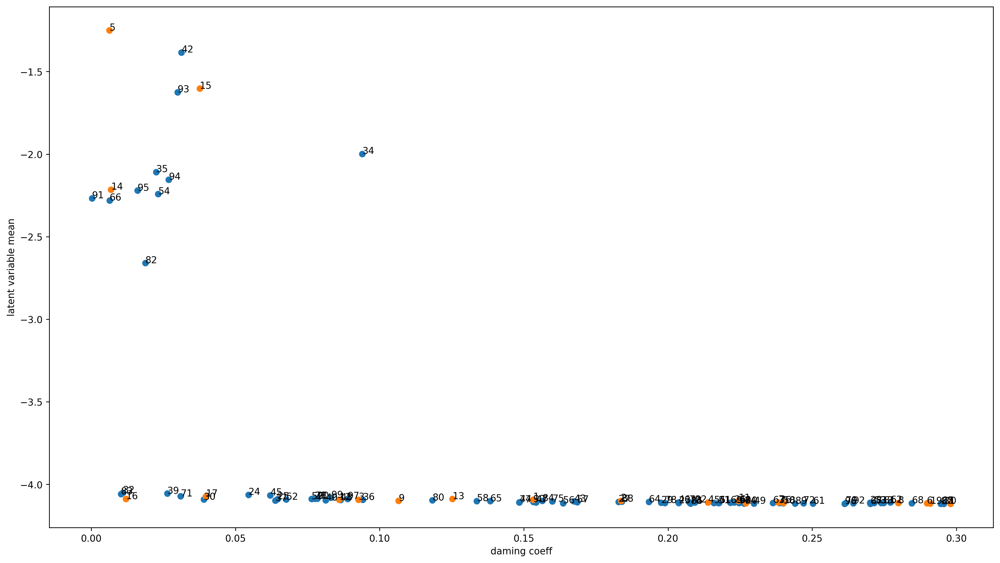

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_iter0.eps")
plt.savefig(figfilenamehead+"damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  1  2  3  

/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict diverge [   7.74578972 -150.78676298]
43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict 

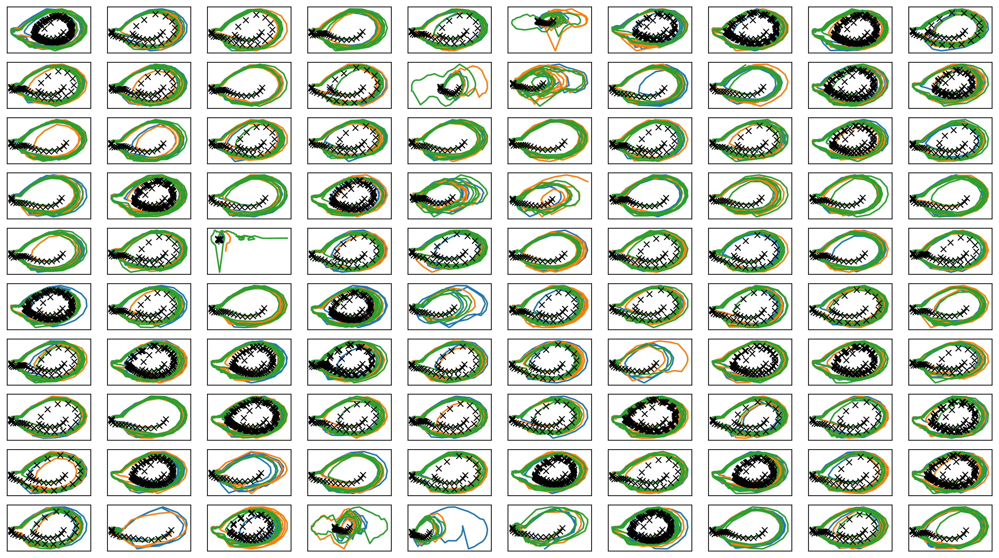

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter0.png")
plt.savefig(figfilenamehead+"joint_iter0.eps")
plt.savefig(figfilenamehead+"joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-03-25 14:06:02.246226


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  predict diverge [ 78.35888863 109.75004943]
predict diverge [ 78.5123278  120.73713793]
predict diverge [ 91.24327978 133.2833583 ]
predict diverge [133.55932025 146.71809417]
predict diverge [3465.7581275   159.51902685]
6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict diverge [    1.06375661 -1029.40666992]
43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.37288  validloss 1.47296±0.00000  bestvalidloss 1.47296  last_update 0
train: iter 1  trainloss 1.14071  validloss 1.27572±0.00000  bestvalidloss 1.27572  last_update 0
train: iter 2  trainloss 0.91714  validloss 1.01142±0.00000  bestvalidloss 1.01142  last_update 0
train: iter 3  trainloss 0.80316  validloss 0.85350±0.00000  bestvalidloss 0.85350  last_update 0
train: iter 4  trainloss 0.73782  validloss 0.77448±0.00000  bestvalidloss 0.77448  last_update 0
train: iter 5  trainloss 0.69669  validloss 0.72332±0.00000  bestvalidloss 0.72332  last_update 0
train: iter 6  trainloss 0.66369  validloss 0.68475±0.00000  bestvalidloss 0.68475  last_update 0
train: iter 7  trainloss 0.63579  validloss 0.65210±0.00000  bestvalidloss 0.65210  last_update 0
train: iter 8  trainloss 0.60537  validloss 0.61902±0.00000  bestvalidloss 0.61902  last_update 0
train: iter 9  trainloss 0.57633  validloss 0.58678±0.00000  bestvalidloss 0.58678  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.20609  validloss 0.26928±0.00000  bestvalidloss 0.26928  last_update 0
train: iter 84  trainloss 0.20561  validloss 0.26958±0.00000  bestvalidloss 0.26928  last_update 1
train: iter 85  trainloss 0.20533  validloss 0.26872±0.00000  bestvalidloss 0.26872  last_update 0
train: iter 86  trainloss 0.20387  validloss 0.26702±0.00000  bestvalidloss 0.26702  last_update 0
train: iter 87  trainloss 0.20264  validloss 0.27018±0.00000  bestvalidloss 0.26702  last_update 1
train: iter 88  trainloss 0.20082  validloss 0.26725±0.00000  bestvalidloss 0.26702  last_update 2
train: iter 89  trainloss 0.20056  validloss 0.27200±0.00000  bestvalidloss 0.26702  last_update 3
train: iter 90  trainloss 0.19938  validloss 0.26659±0.00000  bestvalidloss 0.26659  last_update 0
train: iter 91  trainloss 0.19881  validloss 0.26511±0.00000  bestvalidloss 0.26511  last_update 0
train: iter 92  trainloss 0.19815  validloss 0.26605±0.00000  bestvalidloss 0.26511  last_update 1
train: ite

train: iter 167  trainloss 0.17029  validloss 0.25069±0.00000  bestvalidloss 0.24608  last_update 6
train: iter 168  trainloss 0.16979  validloss 0.24956±0.00000  bestvalidloss 0.24608  last_update 7
train: iter 169  trainloss 0.17389  validloss 0.24843±0.00000  bestvalidloss 0.24608  last_update 8
train: iter 170  trainloss 0.16864  validloss 0.25413±0.00000  bestvalidloss 0.24608  last_update 9
train: iter 171  trainloss 0.16720  validloss 0.24539±0.00000  bestvalidloss 0.24539  last_update 0
train: iter 172  trainloss 0.16960  validloss 0.24475±0.00000  bestvalidloss 0.24475  last_update 0
train: iter 173  trainloss 0.16740  validloss 0.25861±0.00000  bestvalidloss 0.24475  last_update 1
train: iter 174  trainloss 0.16795  validloss 0.24570±0.00000  bestvalidloss 0.24475  last_update 2
train: iter 175  trainloss 0.16742  validloss 0.24901±0.00000  bestvalidloss 0.24475  last_update 3
train: iter 176  trainloss 0.16756  validloss 0.24508±0.00000  bestvalidloss 0.24475  last_update 4


train: iter 252  trainloss 0.15456  validloss 0.23371±0.00000  bestvalidloss 0.23371  last_update 0
train: iter 253  trainloss 0.15453  validloss 0.23444±0.00000  bestvalidloss 0.23371  last_update 1
train: iter 254  trainloss 0.15471  validloss 0.23542±0.00000  bestvalidloss 0.23371  last_update 2
train: iter 255  trainloss 0.15551  validloss 0.23333±0.00000  bestvalidloss 0.23333  last_update 0
train: iter 256  trainloss 0.15669  validloss 0.23543±0.00000  bestvalidloss 0.23333  last_update 1
train: iter 257  trainloss 0.15614  validloss 0.23525±0.00000  bestvalidloss 0.23333  last_update 2
train: iter 258  trainloss 0.15338  validloss 0.23405±0.00000  bestvalidloss 0.23333  last_update 3
train: iter 259  trainloss 0.15463  validloss 0.23849±0.00000  bestvalidloss 0.23333  last_update 4
train: iter 260  trainloss 0.15464  validloss 0.23516±0.00000  bestvalidloss 0.23333  last_update 5
train: iter 261  trainloss 0.15248  validloss 0.23700±0.00000  bestvalidloss 0.23333  last_update 6


train: iter 335  trainloss 0.14539  validloss 0.22831±0.00000  bestvalidloss 0.22669  last_update 1
train: iter 336  trainloss 0.14432  validloss 0.22648±0.00000  bestvalidloss 0.22648  last_update 0
train: iter 337  trainloss 0.14666  validloss 0.23013±0.00000  bestvalidloss 0.22648  last_update 1
train: iter 338  trainloss 0.15132  validloss 0.25808±0.00000  bestvalidloss 0.22648  last_update 2
train: iter 339  trainloss 0.14578  validloss 0.22754±0.00000  bestvalidloss 0.22648  last_update 3
train: iter 340  trainloss 0.14496  validloss 0.22724±0.00000  bestvalidloss 0.22648  last_update 4
train: iter 341  trainloss 0.14582  validloss 0.23083±0.00000  bestvalidloss 0.22648  last_update 5
train: iter 342  trainloss 0.14416  validloss 0.22682±0.00000  bestvalidloss 0.22648  last_update 6
train: iter 343  trainloss 0.14547  validloss 0.23096±0.00000  bestvalidloss 0.22648  last_update 7
train: iter 344  trainloss 0.14684  validloss 0.22811±0.00000  bestvalidloss 0.22648  last_update 8


train: iter 420  trainloss 0.13911  validloss 0.22260±0.00000  bestvalidloss 0.22260  last_update 0
train: iter 421  trainloss 0.13936  validloss 0.22785±0.00000  bestvalidloss 0.22260  last_update 1
train: iter 422  trainloss 0.14174  validloss 0.22404±0.00000  bestvalidloss 0.22260  last_update 2
train: iter 423  trainloss 0.14326  validloss 0.22206±0.00000  bestvalidloss 0.22206  last_update 0
train: iter 424  trainloss 0.14020  validloss 0.22585±0.00000  bestvalidloss 0.22206  last_update 1
train: iter 425  trainloss 0.14039  validloss 0.22324±0.00000  bestvalidloss 0.22206  last_update 2
train: iter 426  trainloss 0.13950  validloss 0.22866±0.00000  bestvalidloss 0.22206  last_update 3
train: iter 427  trainloss 0.14283  validloss 0.22528±0.00000  bestvalidloss 0.22206  last_update 4
train: iter 428  trainloss 0.13830  validloss 0.22193±0.00000  bestvalidloss 0.22193  last_update 0
train: iter 429  trainloss 0.13888  validloss 0.22399±0.00000  bestvalidloss 0.22193  last_update 1


train: iter 505  trainloss 0.13341  validloss 0.22115±0.00000  bestvalidloss 0.22024  last_update 11
train: iter 506  trainloss 0.13360  validloss 0.22086±0.00000  bestvalidloss 0.22024  last_update 12
train: iter 507  trainloss 0.13422  validloss 0.21912±0.00000  bestvalidloss 0.21912  last_update 0
train: iter 508  trainloss 0.13233  validloss 0.22199±0.00000  bestvalidloss 0.21912  last_update 1
train: iter 509  trainloss 0.13793  validloss 0.22073±0.00000  bestvalidloss 0.21912  last_update 2
train: iter 510  trainloss 0.13318  validloss 0.22665±0.00000  bestvalidloss 0.21912  last_update 3
train: iter 511  trainloss 0.13347  validloss 0.22577±0.00000  bestvalidloss 0.21912  last_update 4
train: iter 512  trainloss 0.13413  validloss 0.22425±0.00000  bestvalidloss 0.21912  last_update 5
train: iter 513  trainloss 0.13217  validloss 0.22198±0.00000  bestvalidloss 0.21912  last_update 6
train: iter 514  trainloss 0.13403  validloss 0.22344±0.00000  bestvalidloss 0.21912  last_update 

train: iter 589  trainloss 0.12655  validloss 0.21181±0.00000  bestvalidloss 0.21181  last_update 0
train: iter 590  trainloss 0.12693  validloss 0.21294±0.00000  bestvalidloss 0.21181  last_update 1
train: iter 591  trainloss 0.12735  validloss 0.21266±0.00000  bestvalidloss 0.21181  last_update 2
train: iter 592  trainloss 0.12670  validloss 0.21986±0.00000  bestvalidloss 0.21181  last_update 3
train: iter 593  trainloss 0.12783  validloss 0.21608±0.00000  bestvalidloss 0.21181  last_update 4
train: iter 594  trainloss 0.12723  validloss 0.22129±0.00000  bestvalidloss 0.21181  last_update 5
train: iter 595  trainloss 0.12583  validloss 0.21427±0.00000  bestvalidloss 0.21181  last_update 6
train: iter 596  trainloss 0.12984  validloss 0.21401±0.00000  bestvalidloss 0.21181  last_update 7
train: iter 597  trainloss 0.12963  validloss 0.21852±0.00000  bestvalidloss 0.21181  last_update 8
train: iter 598  trainloss 0.12916  validloss 0.21649±0.00000  bestvalidloss 0.21181  last_update 9


train: iter 674  trainloss 0.12242  validloss 0.21166±0.00000  bestvalidloss 0.20840  last_update 6
train: iter 675  trainloss 0.12084  validloss 0.21026±0.00000  bestvalidloss 0.20840  last_update 7
train: iter 676  trainloss 0.12212  validloss 0.20881±0.00000  bestvalidloss 0.20840  last_update 8
train: iter 677  trainloss 0.12166  validloss 0.21031±0.00000  bestvalidloss 0.20840  last_update 9
train: iter 678  trainloss 0.12074  validloss 0.21344±0.00000  bestvalidloss 0.20840  last_update 10
train: iter 679  trainloss 0.12028  validloss 0.21091±0.00000  bestvalidloss 0.20840  last_update 11
train: iter 680  trainloss 0.12012  validloss 0.20905±0.00000  bestvalidloss 0.20840  last_update 12
train: iter 681  trainloss 0.12115  validloss 0.21021±0.00000  bestvalidloss 0.20840  last_update 13
train: iter 682  trainloss 0.12001  validloss 0.21186±0.00000  bestvalidloss 0.20840  last_update 14
train: iter 683  trainloss 0.11993  validloss 0.20897±0.00000  bestvalidloss 0.20840  last_upda

train: iter 758  trainloss 0.11809  validloss 0.20870±0.00000  bestvalidloss 0.20650  last_update 21
train: iter 759  trainloss 0.11678  validloss 0.20804±0.00000  bestvalidloss 0.20650  last_update 22
train: iter 760  trainloss 0.11692  validloss 0.21047±0.00000  bestvalidloss 0.20650  last_update 23
train: iter 761  trainloss 0.12042  validloss 0.21058±0.00000  bestvalidloss 0.20650  last_update 24
train: iter 762  trainloss 0.11721  validloss 0.20914±0.00000  bestvalidloss 0.20650  last_update 25
train: iter 763  trainloss 0.11848  validloss 0.20619±0.00000  bestvalidloss 0.20619  last_update 0
train: iter 764  trainloss 0.11670  validloss 0.21197±0.00000  bestvalidloss 0.20619  last_update 1
train: iter 765  trainloss 0.11657  validloss 0.21152±0.00000  bestvalidloss 0.20619  last_update 2
train: iter 766  trainloss 0.11937  validloss 0.20825±0.00000  bestvalidloss 0.20619  last_update 3
train: iter 767  trainloss 0.12098  validloss 0.20814±0.00000  bestvalidloss 0.20619  last_upda

train: iter 843  trainloss 0.11704  validloss 0.21616±0.00000  bestvalidloss 0.20588  last_update 51
train: iter 844  trainloss 0.11272  validloss 0.21620±0.00000  bestvalidloss 0.20588  last_update 52
train: iter 845  trainloss 0.11169  validloss 0.21080±0.00000  bestvalidloss 0.20588  last_update 53
train: iter 846  trainloss 0.11392  validloss 0.20970±0.00000  bestvalidloss 0.20588  last_update 54
train: iter 847  trainloss 0.11302  validloss 0.21016±0.00000  bestvalidloss 0.20588  last_update 55
train: iter 848  trainloss 0.11127  validloss 0.21428±0.00000  bestvalidloss 0.20588  last_update 56
train: iter 849  trainloss 0.11729  validloss 0.20782±0.00000  bestvalidloss 0.20588  last_update 57
train: iter 850  trainloss 0.13680  validloss 0.26510±0.00000  bestvalidloss 0.20588  last_update 58
train: iter 851  trainloss 0.11150  validloss 0.21408±0.00000  bestvalidloss 0.20588  last_update 59
train: iter 852  trainloss 0.11020  validloss 0.21092±0.00000  bestvalidloss 0.20588  last_

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -92.63886812418698
valid_loss:  -134.53220906972885
train_loss:  -56.0666651982069
valid_loss:  -52.17417947292328


1e-08 1000.0


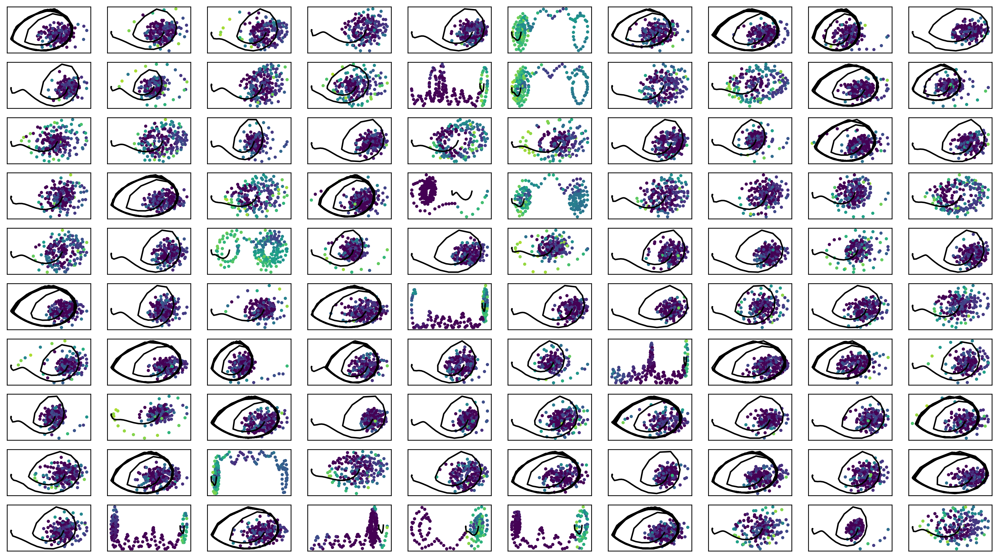

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -55.39658  validloss -52.74192±0.00000  bestvalidloss -52.74192  last_update 0
train: iter 1  trainloss -57.53914  validloss -55.92121±0.00000  bestvalidloss -55.92121  last_update 0
train: iter 2  trainloss -60.72607  validloss -58.33098±0.00000  bestvalidloss -58.33098  last_update 0
train: iter 3  trainloss -62.72534  validloss -60.31197±0.00000  bestvalidloss -60.31197  last_update 0
train: iter 4  trainloss -67.15799  validloss -57.09791±0.00000  bestvalidloss -60.31197  last_update 1
train: iter 5  trainloss -65.34009  validloss -57.17228±0.00000  bestvalidloss -60.31197  last_update 2
train: iter 6  trainloss -67.83903  validloss -56.53990±0.00000  bestvalidloss -60.31197  last_update 3
train: iter 7  trainloss -73.67516  validloss -63.86664±0.00000  bestvalidloss -63.86664  last_update 0
train: iter 8  trainloss -70.06809  validloss -65.67616±0.00000  bestvalidloss -65.67616  last_update 0
train: iter 9  trainloss -73.11695  

train: iter 79  trainloss -171.07509  validloss -153.54684±0.00000  bestvalidloss -155.46523  last_update 1
train: iter 80  trainloss -174.05181  validloss -152.50325±0.00000  bestvalidloss -155.46523  last_update 2
train: iter 81  trainloss -176.34432  validloss -163.67322±0.00000  bestvalidloss -163.67322  last_update 0
train: iter 82  trainloss -171.24254  validloss -153.59266±0.00000  bestvalidloss -163.67322  last_update 1
train: iter 83  trainloss -172.28142  validloss -138.40232±0.00000  bestvalidloss -163.67322  last_update 2
train: iter 84  trainloss -175.33658  validloss -155.90176±0.00000  bestvalidloss -163.67322  last_update 3
train: iter 85  trainloss -176.46784  validloss -162.32112±0.00000  bestvalidloss -163.67322  last_update 4
train: iter 86  trainloss -179.03395  validloss -156.61629±0.00000  bestvalidloss -163.67322  last_update 5
train: iter 87  trainloss -177.85351  validloss -149.39708±0.00000  bestvalidloss -163.67322  last_update 6
train: iter 88  trainloss -1

train: iter 156  trainloss -202.88955  validloss -189.76978±0.00000  bestvalidloss -203.08803  last_update 2
train: iter 157  trainloss -204.13066  validloss -198.57556±0.00000  bestvalidloss -203.08803  last_update 3
train: iter 158  trainloss -210.95772  validloss -204.52986±0.00000  bestvalidloss -204.52986  last_update 0
train: iter 159  trainloss -211.13362  validloss -197.17235±0.00000  bestvalidloss -204.52986  last_update 1
train: iter 160  trainloss -213.34518  validloss -207.12057±0.00000  bestvalidloss -207.12057  last_update 0
train: iter 161  trainloss -215.59235  validloss -199.78587±0.00000  bestvalidloss -207.12057  last_update 1
train: iter 162  trainloss -216.46578  validloss -202.38349±0.00000  bestvalidloss -207.12057  last_update 2
train: iter 163  trainloss -212.65568  validloss -159.77999±0.00000  bestvalidloss -207.12057  last_update 3
train: iter 164  trainloss -210.55200  validloss -196.76988±0.00000  bestvalidloss -207.12057  last_update 4
train: iter 165  tr

train: iter 232  trainloss -242.67671  validloss -229.51938±0.00000  bestvalidloss -238.06374  last_update 7
train: iter 233  trainloss -237.45804  validloss -238.63156±0.00000  bestvalidloss -238.63156  last_update 0
train: iter 234  trainloss -246.35883  validloss -243.31059±0.00000  bestvalidloss -243.31059  last_update 0
train: iter 235  trainloss -247.19475  validloss -228.55429±0.00000  bestvalidloss -243.31059  last_update 1
train: iter 236  trainloss -245.60057  validloss -225.40512±0.00000  bestvalidloss -243.31059  last_update 2
train: iter 237  trainloss -241.91002  validloss -220.81506±0.00000  bestvalidloss -243.31059  last_update 3
train: iter 238  trainloss -243.40375  validloss -237.36506±0.00000  bestvalidloss -243.31059  last_update 4
train: iter 239  trainloss -241.32013  validloss -226.11752±0.00000  bestvalidloss -243.31059  last_update 5
train: iter 240  trainloss -245.90442  validloss -222.65780±0.00000  bestvalidloss -243.31059  last_update 6
train: iter 241  tr

train: iter 307  trainloss -268.96039  validloss -259.20148±0.00000  bestvalidloss -264.66577  last_update 11
train: iter 308  trainloss -260.00008  validloss -261.78400±0.00000  bestvalidloss -264.66577  last_update 12
train: iter 309  trainloss -268.51632  validloss -258.40146±0.00000  bestvalidloss -264.66577  last_update 13
train: iter 310  trainloss -265.92900  validloss -258.01940±0.00000  bestvalidloss -264.66577  last_update 14
train: iter 311  trainloss -258.38077  validloss -220.17372±0.00000  bestvalidloss -264.66577  last_update 15
train: iter 312  trainloss -261.23634  validloss -247.48580±0.00000  bestvalidloss -264.66577  last_update 16
train: iter 313  trainloss -269.35599  validloss -264.31775±0.00000  bestvalidloss -264.66577  last_update 17
train: iter 314  trainloss -250.08584  validloss -262.55127±0.00000  bestvalidloss -264.66577  last_update 18
train: iter 315  trainloss -270.32817  validloss -266.68173±0.00000  bestvalidloss -266.68173  last_update 0
train: iter

train: iter 383  trainloss -283.30130  validloss -287.49614±0.00000  bestvalidloss -287.49614  last_update 0
train: iter 384  trainloss -279.74467  validloss -271.78031±0.00000  bestvalidloss -287.49614  last_update 1
train: iter 385  trainloss -285.13686  validloss -221.97725±0.00000  bestvalidloss -287.49614  last_update 2
train: iter 386  trainloss -279.92200  validloss -271.95664±0.00000  bestvalidloss -287.49614  last_update 3
train: iter 387  trainloss -280.07745  validloss -266.85449±0.00000  bestvalidloss -287.49614  last_update 4
train: iter 388  trainloss -284.92246  validloss -279.73496±0.00000  bestvalidloss -287.49614  last_update 5
train: iter 389  trainloss -289.88813  validloss -273.14603±0.00000  bestvalidloss -287.49614  last_update 6
train: iter 390  trainloss -280.07887  validloss -284.53605±0.00000  bestvalidloss -287.49614  last_update 7
train: iter 391  trainloss -287.59998  validloss -275.44598±0.00000  bestvalidloss -287.49614  last_update 8
train: iter 392  tr

train: iter 458  trainloss -303.39079  validloss -284.71857±0.00000  bestvalidloss -303.52834  last_update 6
train: iter 459  trainloss -307.70468  validloss -267.27283±0.00000  bestvalidloss -303.52834  last_update 7
train: iter 460  trainloss -301.05980  validloss -283.66511±0.00000  bestvalidloss -303.52834  last_update 8
train: iter 461  trainloss -306.03971  validloss -287.44907±0.00000  bestvalidloss -303.52834  last_update 9
train: iter 462  trainloss -302.62381  validloss -283.24276±0.00000  bestvalidloss -303.52834  last_update 10
train: iter 463  trainloss -299.39581  validloss -240.70095±0.00000  bestvalidloss -303.52834  last_update 11
train: iter 464  trainloss -303.15091  validloss -236.40719±0.00000  bestvalidloss -303.52834  last_update 12
train: iter 465  trainloss -301.85799  validloss -302.19403±0.00000  bestvalidloss -303.52834  last_update 13
train: iter 466  trainloss -310.91946  validloss -304.63890±0.00000  bestvalidloss -304.63890  last_update 0
train: iter 467

train: iter 533  trainloss -330.40968  validloss -295.06850±0.00000  bestvalidloss -323.47494  last_update 34
train: iter 534  trainloss -329.13468  validloss -295.76977±0.00000  bestvalidloss -323.47494  last_update 35
train: iter 535  trainloss -326.93492  validloss -313.33561±0.00000  bestvalidloss -323.47494  last_update 36
train: iter 536  trainloss -331.59033  validloss -295.15287±0.00000  bestvalidloss -323.47494  last_update 37
train: iter 537  trainloss -332.46205  validloss -298.60678±0.00000  bestvalidloss -323.47494  last_update 38
train: iter 538  trainloss -325.72003  validloss -295.92082±0.00000  bestvalidloss -323.47494  last_update 39
train: iter 539  trainloss -319.13810  validloss -309.65511±0.00000  bestvalidloss -323.47494  last_update 40
train: iter 540  trainloss -324.41592  validloss -270.20871±0.00000  bestvalidloss -323.47494  last_update 41
train: iter 541  trainloss -312.41609  validloss -278.55725±0.00000  bestvalidloss -323.47494  last_update 42
train: ite

train: iter 608  trainloss -333.84077  validloss -304.54026±0.00000  bestvalidloss -332.96093  last_update 10
train: iter 609  trainloss -345.67782  validloss -315.94806±0.00000  bestvalidloss -332.96093  last_update 11
train: iter 610  trainloss -338.64612  validloss -323.87038±0.00000  bestvalidloss -332.96093  last_update 12
train: iter 611  trainloss -337.94289  validloss -321.82637±0.00000  bestvalidloss -332.96093  last_update 13
train: iter 612  trainloss -346.65909  validloss -296.26891±0.00000  bestvalidloss -332.96093  last_update 14
train: iter 613  trainloss -337.90877  validloss -265.04311±0.00000  bestvalidloss -332.96093  last_update 15
train: iter 614  trainloss -338.47701  validloss -307.04274±0.00000  bestvalidloss -332.96093  last_update 16
train: iter 615  trainloss -331.99245  validloss -328.50670±0.00000  bestvalidloss -332.96093  last_update 17
train: iter 616  trainloss -347.92098  validloss -335.66422±0.00000  bestvalidloss -335.66422  last_update 0
train: iter

train: iter 683  trainloss -349.03868  validloss -323.09840±0.00000  bestvalidloss -352.30739  last_update 34
train: iter 684  trainloss -354.48915  validloss -296.70633±0.00000  bestvalidloss -352.30739  last_update 35
train: iter 685  trainloss -352.61716  validloss -348.48960±0.00000  bestvalidloss -352.30739  last_update 36
train: iter 686  trainloss -353.46082  validloss -345.81149±0.00000  bestvalidloss -352.30739  last_update 37
train: iter 687  trainloss -348.18981  validloss -328.70229±0.00000  bestvalidloss -352.30739  last_update 38
train: iter 688  trainloss -353.55107  validloss -299.46593±0.00000  bestvalidloss -352.30739  last_update 39
train: iter 689  trainloss -358.28644  validloss -335.75784±0.00000  bestvalidloss -352.30739  last_update 40
train: iter 690  trainloss -357.23592  validloss -338.74234±0.00000  bestvalidloss -352.30739  last_update 41
train: iter 691  trainloss -361.98710  validloss -343.28176±0.00000  bestvalidloss -352.30739  last_update 42
train: ite

train: iter 758  trainloss -371.18524  validloss -348.21946±0.00000  bestvalidloss -365.67949  last_update 27
train: iter 759  trainloss -373.24557  validloss -343.86340±0.00000  bestvalidloss -365.67949  last_update 28
train: iter 760  trainloss -377.53331  validloss -340.82286±0.00000  bestvalidloss -365.67949  last_update 29
train: iter 761  trainloss -374.80307  validloss -335.78951±0.00000  bestvalidloss -365.67949  last_update 30
train: iter 762  trainloss -356.08175  validloss -270.43979±0.00000  bestvalidloss -365.67949  last_update 31
train: iter 763  trainloss -372.71206  validloss -311.64358±0.00000  bestvalidloss -365.67949  last_update 32
train: iter 764  trainloss -372.08685  validloss -356.49550±0.00000  bestvalidloss -365.67949  last_update 33
train: iter 765  trainloss -379.85175  validloss -332.14935±0.00000  bestvalidloss -365.67949  last_update 34
train: iter 766  trainloss -378.76302  validloss -344.33643±0.00000  bestvalidloss -365.67949  last_update 35
train: ite

train: iter 833  trainloss -390.27241  validloss -287.17339±0.00000  bestvalidloss -377.05837  last_update 14
train: iter 834  trainloss -380.46344  validloss -275.66097±0.00000  bestvalidloss -377.05837  last_update 15
train: iter 835  trainloss -391.37950  validloss -337.71253±0.00000  bestvalidloss -377.05837  last_update 16
train: iter 836  trainloss -391.45194  validloss -368.60778±0.00000  bestvalidloss -377.05837  last_update 17
train: iter 837  trainloss -390.98470  validloss -375.05100±0.00000  bestvalidloss -377.05837  last_update 18
train: iter 838  trainloss -390.27510  validloss -352.26467±0.00000  bestvalidloss -377.05837  last_update 19
train: iter 839  trainloss -400.44454  validloss -339.69491±0.00000  bestvalidloss -377.05837  last_update 20
train: iter 840  trainloss -356.14660  validloss -276.10498±0.00000  bestvalidloss -377.05837  last_update 21
train: iter 841  trainloss -367.93183  validloss -343.28216±0.00000  bestvalidloss -377.05837  last_update 22
train: ite

train: iter 908  trainloss -403.48736  validloss -374.03091±0.00000  bestvalidloss -398.47229  last_update 9
train: iter 909  trainloss -415.54514  validloss -384.00077±0.00000  bestvalidloss -398.47229  last_update 10
train: iter 910  trainloss -413.16341  validloss -381.06127±0.00000  bestvalidloss -398.47229  last_update 11
train: iter 911  trainloss -404.09054  validloss -383.17725±0.00000  bestvalidloss -398.47229  last_update 12
train: iter 912  trainloss -412.81119  validloss -380.19620±0.00000  bestvalidloss -398.47229  last_update 13
train: iter 913  trainloss -404.74446  validloss -381.04832±0.00000  bestvalidloss -398.47229  last_update 14
train: iter 914  trainloss -420.10397  validloss -376.24731±0.00000  bestvalidloss -398.47229  last_update 15
train: iter 915  trainloss -412.17340  validloss -345.09556±0.00000  bestvalidloss -398.47229  last_update 16
train: iter 916  trainloss -373.57540  validloss -328.45056±0.00000  bestvalidloss -398.47229  last_update 17
train: iter

train: iter 983  trainloss -412.17548  validloss -396.88653±0.00000  bestvalidloss -412.90742  last_update 49
train: iter 984  trainloss -400.69500  validloss -243.92980±0.00000  bestvalidloss -412.90742  last_update 50
train: iter 985  trainloss -427.57355  validloss -396.99912±0.00000  bestvalidloss -412.90742  last_update 51
train: iter 986  trainloss -418.42493  validloss -374.51680±0.00000  bestvalidloss -412.90742  last_update 52
train: iter 987  trainloss -421.99629  validloss -366.78524±0.00000  bestvalidloss -412.90742  last_update 53
train: iter 988  trainloss -436.34979  validloss -414.39366±0.00000  bestvalidloss -414.39366  last_update 0
train: iter 989  trainloss -437.98371  validloss -396.10019±0.00000  bestvalidloss -414.39366  last_update 1
train: iter 990  trainloss -435.35152  validloss -356.87168±0.00000  bestvalidloss -414.39366  last_update 2
train: iter 991  trainloss -436.40119  validloss -395.13373±0.00000  bestvalidloss -414.39366  last_update 3
train: iter 99

train: iter 1059  trainloss -455.53671  validloss -406.11928±0.00000  bestvalidloss -433.28788  last_update 22
train: iter 1060  trainloss -456.65703  validloss -418.23804±0.00000  bestvalidloss -433.28788  last_update 23
train: iter 1061  trainloss -461.35595  validloss -358.65797±0.00000  bestvalidloss -433.28788  last_update 24
train: iter 1062  trainloss -447.02972  validloss -378.04322±0.00000  bestvalidloss -433.28788  last_update 25
train: iter 1063  trainloss -410.81144  validloss -365.49031±0.00000  bestvalidloss -433.28788  last_update 26
train: iter 1064  trainloss -412.23640  validloss -370.84606±0.00000  bestvalidloss -433.28788  last_update 27
train: iter 1065  trainloss -448.78574  validloss -393.31649±0.00000  bestvalidloss -433.28788  last_update 28
train: iter 1066  trainloss -439.32725  validloss -272.36516±0.00000  bestvalidloss -433.28788  last_update 29
train: iter 1067  trainloss -448.24801  validloss -409.21092±0.00000  bestvalidloss -433.28788  last_update 30
t

train: iter 1133  trainloss -461.00375  validloss -444.49170±0.00000  bestvalidloss -444.49170  last_update 0
train: iter 1134  trainloss -474.12581  validloss -443.89998±0.00000  bestvalidloss -444.49170  last_update 1
train: iter 1135  trainloss -482.94422  validloss -430.10451±0.00000  bestvalidloss -444.49170  last_update 2
train: iter 1136  trainloss -471.16850  validloss -426.38072±0.00000  bestvalidloss -444.49170  last_update 3
train: iter 1137  trainloss -482.03412  validloss -424.33989±0.00000  bestvalidloss -444.49170  last_update 4
train: iter 1138  trainloss -483.69494  validloss -416.70465±0.00000  bestvalidloss -444.49170  last_update 5
train: iter 1139  trainloss -474.05701  validloss -441.41943±0.00000  bestvalidloss -444.49170  last_update 6
train: iter 1140  trainloss -476.66002  validloss -423.22128±0.00000  bestvalidloss -444.49170  last_update 7
train: iter 1141  trainloss -417.49883  validloss -304.98444±0.00000  bestvalidloss -444.49170  last_update 8
train: ite

train: iter 1208  trainloss -494.11546  validloss -458.13953±0.00000  bestvalidloss -471.63601  last_update 7
train: iter 1209  trainloss -487.52562  validloss -443.83884±0.00000  bestvalidloss -471.63601  last_update 8
train: iter 1210  trainloss -491.75146  validloss -356.89256±0.00000  bestvalidloss -471.63601  last_update 9
train: iter 1211  trainloss -495.46323  validloss -329.76375±0.00000  bestvalidloss -471.63601  last_update 10
train: iter 1212  trainloss -506.24320  validloss -418.17467±0.00000  bestvalidloss -471.63601  last_update 11
train: iter 1213  trainloss -482.62432  validloss -423.50161±0.00000  bestvalidloss -471.63601  last_update 12
train: iter 1214  trainloss -487.24675  validloss -363.60633±0.00000  bestvalidloss -471.63601  last_update 13
train: iter 1215  trainloss -472.66781  validloss -409.05733±0.00000  bestvalidloss -471.63601  last_update 14
train: iter 1216  trainloss -485.90954  validloss -389.55509±0.00000  bestvalidloss -471.63601  last_update 15
trai

train: iter 1282  trainloss -479.51976  validloss -399.64975±0.00000  bestvalidloss -480.94443  last_update 25
train: iter 1283  trainloss -484.55278  validloss -402.21201±0.00000  bestvalidloss -480.94443  last_update 26
train: iter 1284  trainloss -481.16192  validloss -411.52187±0.00000  bestvalidloss -480.94443  last_update 27
train: iter 1285  trainloss -478.57166  validloss -431.19956±0.00000  bestvalidloss -480.94443  last_update 28
train: iter 1286  trainloss -492.50409  validloss -419.26992±0.00000  bestvalidloss -480.94443  last_update 29
train: iter 1287  trainloss -475.63929  validloss -330.04808±0.00000  bestvalidloss -480.94443  last_update 30
train: iter 1288  trainloss -489.79534  validloss -411.15761±0.00000  bestvalidloss -480.94443  last_update 31
train: iter 1289  trainloss -482.68047  validloss -360.44310±0.00000  bestvalidloss -480.94443  last_update 32
train: iter 1290  trainloss -492.41667  validloss -436.85565±0.00000  bestvalidloss -480.94443  last_update 33
t

train: iter 1357  trainloss -517.06826  validloss -402.94265±0.00000  bestvalidloss -480.94443  last_update 100
train: fin


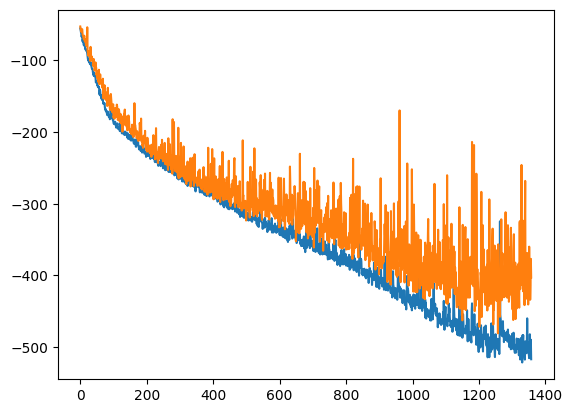

train_weighted_vae: enc
train: iter 0  trainloss -522.78176  validloss -411.67179±0.00000  bestvalidloss -411.67179  last_update 0
train: iter 1  trainloss -493.10720  validloss -450.81913±0.00000  bestvalidloss -450.81913  last_update 0
train: iter 2  trainloss -509.09446  validloss -167.14403±0.00000  bestvalidloss -450.81913  last_update 1
train: iter 3  trainloss -528.64440  validloss -409.40210±0.00000  bestvalidloss -450.81913  last_update 2
train: iter 4  trainloss -531.76946  validloss -413.32308±0.00000  bestvalidloss -450.81913  last_update 3
train: iter 5  trainloss -532.78092  validloss -403.11992±0.00000  bestvalidloss -450.81913  last_update 4
train: iter 6  trainloss -529.34471  validloss -424.57187±0.00000  bestvalidloss -450.81913  last_update 5
train: iter 7  trainloss -529.97678  validloss -414.86622±0.00000  bestvalidloss -450.81913  last_update 6
train: iter 8  trainloss -532.39379  validloss -382.42373±0.00000  bestvalidloss -450.81913  last_update 7
train: iter 9

train: iter 76  trainloss -523.34795  validloss -434.09498±0.00000  bestvalidloss -456.26833  last_update 30
train: iter 77  trainloss -527.75253  validloss -411.88769±0.00000  bestvalidloss -456.26833  last_update 31
train: iter 78  trainloss -523.15315  validloss -413.10341±0.00000  bestvalidloss -456.26833  last_update 32
train: iter 79  trainloss -526.97439  validloss -443.84352±0.00000  bestvalidloss -456.26833  last_update 33
train: iter 80  trainloss -525.91041  validloss -416.62297±0.00000  bestvalidloss -456.26833  last_update 34
train: iter 81  trainloss -521.31636  validloss -356.87287±0.00000  bestvalidloss -456.26833  last_update 35
train: iter 82  trainloss -526.90308  validloss -448.20718±0.00000  bestvalidloss -456.26833  last_update 36
train: iter 83  trainloss -531.45251  validloss -430.33362±0.00000  bestvalidloss -456.26833  last_update 37
train: iter 84  trainloss -534.47046  validloss -421.23132±0.00000  bestvalidloss -456.26833  last_update 38
train: iter 85  tra

train: iter 151  trainloss -529.73995  validloss -417.48610±0.00000  bestvalidloss -458.47580  last_update 25
train: iter 152  trainloss -529.31265  validloss -417.52739±0.00000  bestvalidloss -458.47580  last_update 26
train: iter 153  trainloss -526.82905  validloss -384.27743±0.00000  bestvalidloss -458.47580  last_update 27
train: iter 154  trainloss -526.77267  validloss -436.47646±0.00000  bestvalidloss -458.47580  last_update 28
train: iter 155  trainloss -524.80644  validloss -398.26805±0.00000  bestvalidloss -458.47580  last_update 29
train: iter 156  trainloss -523.78834  validloss -293.90620±0.00000  bestvalidloss -458.47580  last_update 30
train: iter 157  trainloss -530.38544  validloss -414.74645±0.00000  bestvalidloss -458.47580  last_update 31
train: iter 158  trainloss -534.75979  validloss -426.49575±0.00000  bestvalidloss -458.47580  last_update 32
train: iter 159  trainloss -530.73680  validloss -417.73974±0.00000  bestvalidloss -458.47580  last_update 33
train: ite

train: iter 226  trainloss -528.79241  validloss -439.77546±0.00000  bestvalidloss -463.94983  last_update 2
train: iter 227  trainloss -530.33976  validloss -376.81554±0.00000  bestvalidloss -463.94983  last_update 3
train: iter 228  trainloss -522.00577  validloss -423.58358±0.00000  bestvalidloss -463.94983  last_update 4
train: iter 229  trainloss -530.64629  validloss -401.64932±0.00000  bestvalidloss -463.94983  last_update 5
train: iter 230  trainloss -523.20469  validloss -348.48505±0.00000  bestvalidloss -463.94983  last_update 6
train: iter 231  trainloss -528.40440  validloss -393.51279±0.00000  bestvalidloss -463.94983  last_update 7
train: iter 232  trainloss -528.25059  validloss -392.29917±0.00000  bestvalidloss -463.94983  last_update 8
train: iter 233  trainloss -528.30842  validloss -442.46458±0.00000  bestvalidloss -463.94983  last_update 9
train: iter 234  trainloss -530.48266  validloss -393.60897±0.00000  bestvalidloss -463.94983  last_update 10
train: iter 235  t

train: iter 302  trainloss -533.13342  validloss -407.85841±0.00000  bestvalidloss -463.94983  last_update 78
train: iter 303  trainloss -526.88533  validloss -396.73777±0.00000  bestvalidloss -463.94983  last_update 79
train: iter 304  trainloss -517.38635  validloss -439.53462±0.00000  bestvalidloss -463.94983  last_update 80
train: iter 305  trainloss -526.05985  validloss -442.17870±0.00000  bestvalidloss -463.94983  last_update 81
train: iter 306  trainloss -523.89214  validloss -436.94082±0.00000  bestvalidloss -463.94983  last_update 82
train: iter 307  trainloss -532.97511  validloss -396.29489±0.00000  bestvalidloss -463.94983  last_update 83
train: iter 308  trainloss -529.95598  validloss -386.96300±0.00000  bestvalidloss -463.94983  last_update 84
train: iter 309  trainloss -531.95633  validloss -394.66090±0.00000  bestvalidloss -463.94983  last_update 85
train: iter 310  trainloss -531.78492  validloss -404.68949±0.00000  bestvalidloss -463.94983  last_update 86
train: ite

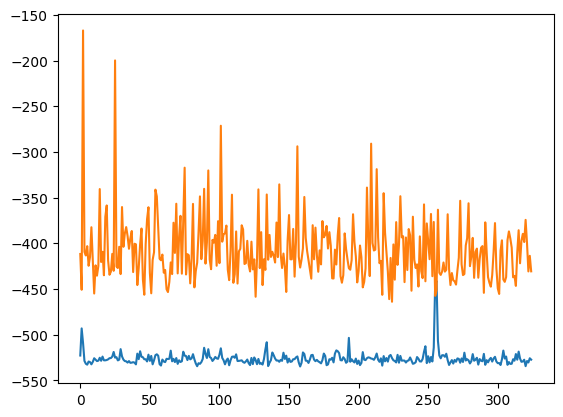

train_weighted_vae: dec
train: iter 0  trainloss -510.31400  validloss -458.35915±0.00000  bestvalidloss -458.35915  last_update 0
train: iter 1  trainloss -519.05132  validloss -448.07722±0.00000  bestvalidloss -458.35915  last_update 1
train: iter 2  trainloss -493.30515  validloss -423.06255±0.00000  bestvalidloss -458.35915  last_update 2
train: iter 3  trainloss -509.26844  validloss -353.28578±0.00000  bestvalidloss -458.35915  last_update 3
train: iter 4  trainloss -509.58868  validloss -391.01029±0.00000  bestvalidloss -458.35915  last_update 4
train: iter 5  trainloss -523.70885  validloss -409.52926±0.00000  bestvalidloss -458.35915  last_update 5
train: iter 6  trainloss -492.29778  validloss -424.30882±0.00000  bestvalidloss -458.35915  last_update 6
train: iter 7  trainloss -497.64450  validloss -392.95615±0.00000  bestvalidloss -458.35915  last_update 7
train: iter 8  trainloss -513.40569  validloss -373.12375±0.00000  bestvalidloss -458.35915  last_update 8
train: iter 9

train: iter 76  trainloss -522.89514  validloss -391.29800±0.00000  bestvalidloss -458.35915  last_update 76
train: iter 77  trainloss -516.06043  validloss -370.04156±0.00000  bestvalidloss -458.35915  last_update 77
train: iter 78  trainloss -514.88418  validloss -388.67785±0.00000  bestvalidloss -458.35915  last_update 78
train: iter 79  trainloss -528.41258  validloss -422.24607±0.00000  bestvalidloss -458.35915  last_update 79
train: iter 80  trainloss -520.46987  validloss -425.22143±0.00000  bestvalidloss -458.35915  last_update 80
train: iter 81  trainloss -528.15106  validloss -398.20366±0.00000  bestvalidloss -458.35915  last_update 81
train: iter 82  trainloss -503.92424  validloss -434.21174±0.00000  bestvalidloss -458.35915  last_update 82
train: iter 83  trainloss -489.58429  validloss -365.66670±0.00000  bestvalidloss -458.35915  last_update 83
train: iter 84  trainloss -507.39667  validloss -362.95570±0.00000  bestvalidloss -458.35915  last_update 84
train: iter 85  tra

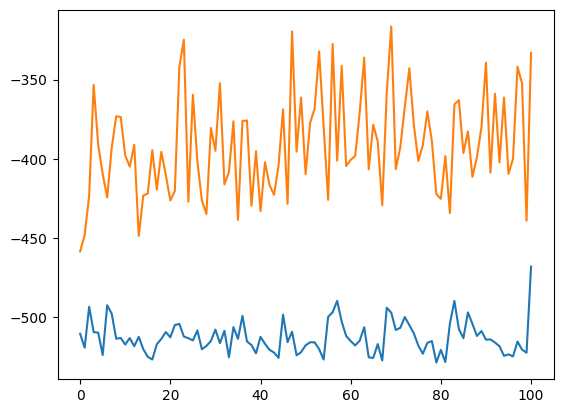

alpha 0.2 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

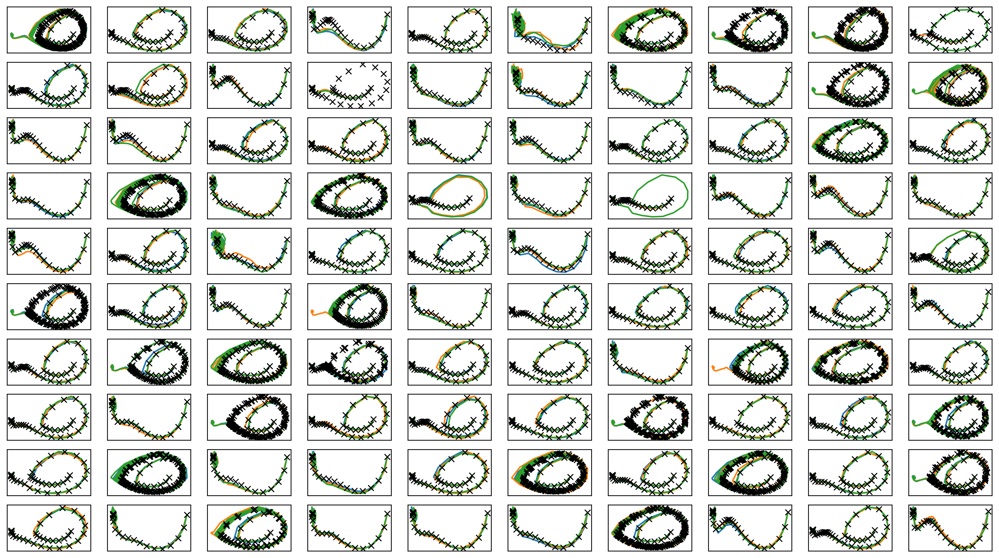

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter1.png")
plt.savefig(figfilenamehead+"joint_iter1.eps")
plt.savefig(figfilenamehead+"joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

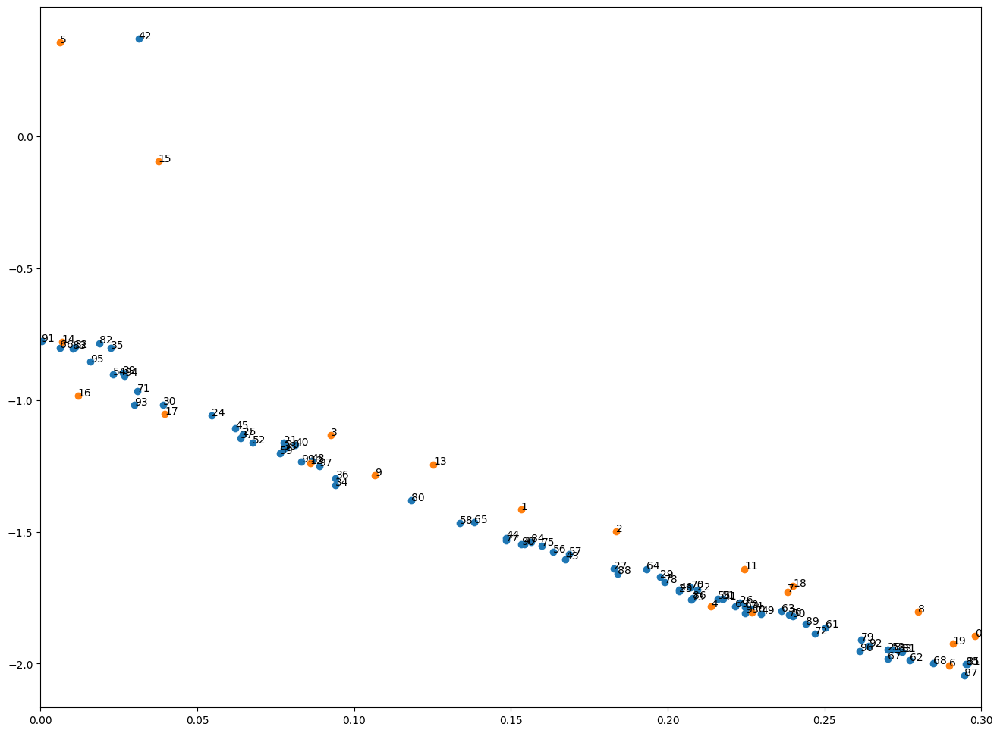

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-03-25 14:13:23.881505


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.38451  validloss 0.56683±0.00000  bestvalidloss 0.56683  last_update 0
train: iter 1  trainloss 0.28695  validloss 0.39024±0.00000  bestvalidloss 0.39024  last_update 0
train: iter 2  trainloss 0.24669  validloss 0.32684±0.00000  bestvalidloss 0.32684  last_update 0
train: iter 3  trainloss 0.22528  validloss 0.29579±0.00000  bestvalidloss 0.29579  last_update 0
train: iter 4  trainloss 0.20981  validloss 0.27940±0.00000  bestvalidloss 0.27940  last_update 0
train: iter 5  trainloss 0.20119  validloss 0.26566±0.00000  bestvalidloss 0.26566  last_update 0
train: iter 6  trainloss 0.19072  validloss 0.26061±0.00000  bestvalidloss 0.26061  last_update 0
train: iter 7  trainloss 0.18447  validloss 0.24258±0.00000  bestvalidloss 0.24258  last_update 0
train: iter 8  trainloss 0.17586  validloss 0.22887±0.00000  bestvalidloss 0.22887  last_update 0
train: iter 9  trainloss 0.17169  validloss 0.22398±0.00000  bestvalidloss 0.22398  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.08697  validloss 0.12693±0.00000  bestvalidloss 0.11790  last_update 5
train: iter 85  trainloss 0.08728  validloss 0.12717±0.00000  bestvalidloss 0.11790  last_update 6
train: iter 86  trainloss 0.08508  validloss 0.11800±0.00000  bestvalidloss 0.11790  last_update 7
train: iter 87  trainloss 0.08600  validloss 0.11803±0.00000  bestvalidloss 0.11790  last_update 8
train: iter 88  trainloss 0.08555  validloss 0.11957±0.00000  bestvalidloss 0.11790  last_update 9
train: iter 89  trainloss 0.08452  validloss 0.11931±0.00000  bestvalidloss 0.11790  last_update 10
train: iter 90  trainloss 0.08658  validloss 0.11576±0.00000  bestvalidloss 0.11576  last_update 0
train: iter 91  trainloss 0.08694  validloss 0.12728±0.00000  bestvalidloss 0.11576  last_update 1
train: iter 92  trainloss 0.08538  validloss 0.12007±0.00000  bestvalidloss 0.11576  last_update 2
train: iter 93  trainloss 0.09106  validloss 0.11881±0.00000  bestvalidloss 0.11576  last_update 3
train: it

train: iter 167  trainloss 0.07094  validloss 0.12179±0.00000  bestvalidloss 0.11312  last_update 61
train: iter 168  trainloss 0.07090  validloss 0.11925±0.00000  bestvalidloss 0.11312  last_update 62
train: iter 169  trainloss 0.07385  validloss 0.12167±0.00000  bestvalidloss 0.11312  last_update 63
train: iter 170  trainloss 0.07330  validloss 0.11992±0.00000  bestvalidloss 0.11312  last_update 64
train: iter 171  trainloss 0.07066  validloss 0.11936±0.00000  bestvalidloss 0.11312  last_update 65
train: iter 172  trainloss 0.07198  validloss 0.12180±0.00000  bestvalidloss 0.11312  last_update 66
train: iter 173  trainloss 0.07319  validloss 0.11963±0.00000  bestvalidloss 0.11312  last_update 67
train: iter 174  trainloss 0.07068  validloss 0.12006±0.00000  bestvalidloss 0.11312  last_update 68
train: iter 175  trainloss 0.07042  validloss 0.11677±0.00000  bestvalidloss 0.11312  last_update 69
train: iter 176  trainloss 0.07098  validloss 0.11867±0.00000  bestvalidloss 0.11312  last_

train: iter 252  trainloss 0.06508  validloss 0.10223±0.00000  bestvalidloss 0.10191  last_update 2
train: iter 253  trainloss 0.06481  validloss 0.10440±0.00000  bestvalidloss 0.10191  last_update 3
train: iter 254  trainloss 0.06443  validloss 0.10173±0.00000  bestvalidloss 0.10173  last_update 0
train: iter 255  trainloss 0.06410  validloss 0.10155±0.00000  bestvalidloss 0.10155  last_update 0
train: iter 256  trainloss 0.07941  validloss 0.10719±0.00000  bestvalidloss 0.10155  last_update 1
train: iter 257  trainloss 0.07156  validloss 0.11511±0.00000  bestvalidloss 0.10155  last_update 2
train: iter 258  trainloss 0.07093  validloss 0.10166±0.00000  bestvalidloss 0.10155  last_update 3
train: iter 259  trainloss 0.06355  validloss 0.10881±0.00000  bestvalidloss 0.10155  last_update 4
train: iter 260  trainloss 0.06230  validloss 0.10660±0.00000  bestvalidloss 0.10155  last_update 5
train: iter 261  trainloss 0.06483  validloss 0.10200±0.00000  bestvalidloss 0.10155  last_update 6


train: iter 337  trainloss 0.06120  validloss 0.11150±0.00000  bestvalidloss 0.09747  last_update 4
train: iter 338  trainloss 0.05961  validloss 0.09873±0.00000  bestvalidloss 0.09747  last_update 5
train: iter 339  trainloss 0.06297  validloss 0.10748±0.00000  bestvalidloss 0.09747  last_update 6
train: iter 340  trainloss 0.05981  validloss 0.10189±0.00000  bestvalidloss 0.09747  last_update 7
train: iter 341  trainloss 0.06447  validloss 0.10353±0.00000  bestvalidloss 0.09747  last_update 8
train: iter 342  trainloss 0.06491  validloss 0.12772±0.00000  bestvalidloss 0.09747  last_update 9
train: iter 343  trainloss 0.06132  validloss 0.10087±0.00000  bestvalidloss 0.09747  last_update 10
train: iter 344  trainloss 0.05979  validloss 0.09932±0.00000  bestvalidloss 0.09747  last_update 11
train: iter 345  trainloss 0.05964  validloss 0.09916±0.00000  bestvalidloss 0.09747  last_update 12
train: iter 346  trainloss 0.05977  validloss 0.09768±0.00000  bestvalidloss 0.09747  last_update

train: iter 422  trainloss 0.05739  validloss 0.10051±0.00000  bestvalidloss 0.09714  last_update 1
train: iter 423  trainloss 0.05523  validloss 0.09871±0.00000  bestvalidloss 0.09714  last_update 2
train: iter 424  trainloss 0.05969  validloss 0.10201±0.00000  bestvalidloss 0.09714  last_update 3
train: iter 425  trainloss 0.05735  validloss 0.09672±0.00000  bestvalidloss 0.09672  last_update 0
train: iter 426  trainloss 0.05509  validloss 0.09958±0.00000  bestvalidloss 0.09672  last_update 1
train: iter 427  trainloss 0.05774  validloss 0.09812±0.00000  bestvalidloss 0.09672  last_update 2
train: iter 428  trainloss 0.06173  validloss 0.10518±0.00000  bestvalidloss 0.09672  last_update 3
train: iter 429  trainloss 0.05726  validloss 0.09895±0.00000  bestvalidloss 0.09672  last_update 4
train: iter 430  trainloss 0.05819  validloss 0.09701±0.00000  bestvalidloss 0.09672  last_update 5
train: iter 431  trainloss 0.05938  validloss 0.09831±0.00000  bestvalidloss 0.09672  last_update 6


train: iter 507  trainloss 0.05347  validloss 0.09647±0.00000  bestvalidloss 0.09489  last_update 2
train: iter 508  trainloss 0.05254  validloss 0.09713±0.00000  bestvalidloss 0.09489  last_update 3
train: iter 509  trainloss 0.05726  validloss 0.09910±0.00000  bestvalidloss 0.09489  last_update 4
train: iter 510  trainloss 0.05474  validloss 0.09623±0.00000  bestvalidloss 0.09489  last_update 5
train: iter 511  trainloss 0.05395  validloss 0.09639±0.00000  bestvalidloss 0.09489  last_update 6
train: iter 512  trainloss 0.05296  validloss 0.09570±0.00000  bestvalidloss 0.09489  last_update 7
train: iter 513  trainloss 0.05342  validloss 0.10182±0.00000  bestvalidloss 0.09489  last_update 8
train: iter 514  trainloss 0.05604  validloss 0.10589±0.00000  bestvalidloss 0.09489  last_update 9
train: iter 515  trainloss 0.05405  validloss 0.09835±0.00000  bestvalidloss 0.09489  last_update 10
train: iter 516  trainloss 0.05371  validloss 0.09495±0.00000  bestvalidloss 0.09489  last_update 1

train: iter 591  trainloss 0.05221  validloss 0.09689±0.00000  bestvalidloss 0.09459  last_update 44
train: iter 592  trainloss 0.05515  validloss 0.10656±0.00000  bestvalidloss 0.09459  last_update 45
train: iter 593  trainloss 0.06455  validloss 0.10119±0.00000  bestvalidloss 0.09459  last_update 46
train: iter 594  trainloss 0.05473  validloss 0.09489±0.00000  bestvalidloss 0.09459  last_update 47
train: iter 595  trainloss 0.05114  validloss 0.09748±0.00000  bestvalidloss 0.09459  last_update 48
train: iter 596  trainloss 0.05310  validloss 0.09489±0.00000  bestvalidloss 0.09459  last_update 49
train: iter 597  trainloss 0.06432  validloss 0.10154±0.00000  bestvalidloss 0.09459  last_update 50
train: iter 598  trainloss 0.05289  validloss 0.09619±0.00000  bestvalidloss 0.09459  last_update 51
train: iter 599  trainloss 0.05205  validloss 0.09535±0.00000  bestvalidloss 0.09459  last_update 52
train: iter 600  trainloss 0.05348  validloss 0.09789±0.00000  bestvalidloss 0.09459  last_

train: iter 675  trainloss 0.04989  validloss 0.10117±0.00000  bestvalidloss 0.09221  last_update 8
train: iter 676  trainloss 0.05006  validloss 0.10353±0.00000  bestvalidloss 0.09221  last_update 9
train: iter 677  trainloss 0.04876  validloss 0.09448±0.00000  bestvalidloss 0.09221  last_update 10
train: iter 678  trainloss 0.05112  validloss 0.09665±0.00000  bestvalidloss 0.09221  last_update 11
train: iter 679  trainloss 0.05065  validloss 0.09353±0.00000  bestvalidloss 0.09221  last_update 12
train: iter 680  trainloss 0.07353  validloss 0.09686±0.00000  bestvalidloss 0.09221  last_update 13
train: iter 681  trainloss 0.05150  validloss 0.10301±0.00000  bestvalidloss 0.09221  last_update 14
train: iter 682  trainloss 0.05099  validloss 0.09851±0.00000  bestvalidloss 0.09221  last_update 15
train: iter 683  trainloss 0.05374  validloss 0.09427±0.00000  bestvalidloss 0.09221  last_update 16
train: iter 684  trainloss 0.04975  validloss 0.09810±0.00000  bestvalidloss 0.09221  last_up

train: iter 760  trainloss 0.05405  validloss 0.09526±0.00000  bestvalidloss 0.09221  last_update 93
train: iter 761  trainloss 0.04966  validloss 0.10701±0.00000  bestvalidloss 0.09221  last_update 94
train: iter 762  trainloss 0.04942  validloss 0.09632±0.00000  bestvalidloss 0.09221  last_update 95
train: iter 763  trainloss 0.04739  validloss 0.10230±0.00000  bestvalidloss 0.09221  last_update 96
train: iter 764  trainloss 0.04853  validloss 0.10137±0.00000  bestvalidloss 0.09221  last_update 97
train: iter 765  trainloss 0.04692  validloss 0.09557±0.00000  bestvalidloss 0.09221  last_update 98
train: iter 766  trainloss 0.04862  validloss 0.09619±0.00000  bestvalidloss 0.09221  last_update 99
train: iter 767  trainloss 0.04828  validloss 0.09884±0.00000  bestvalidloss 0.09221  last_update 100
train: fin


In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -115.79010761901736
valid_loss:  -173.72365092515946
train_loss:  -39.719591129422184
valid_loss:  -27.694625953435896


1e-08 1000.0


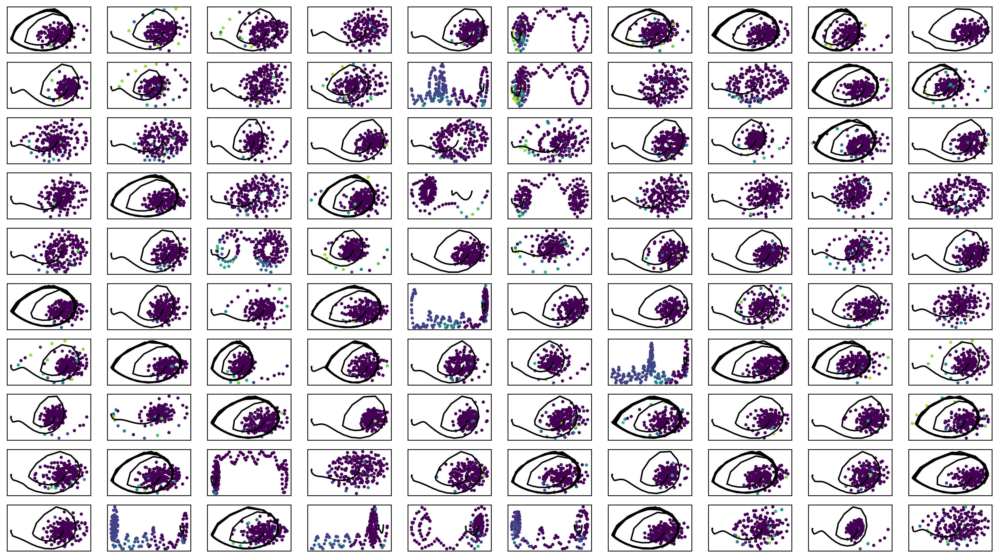

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -38.09334  validloss -30.07429±0.00000  bestvalidloss -30.07429  last_update 0
train: iter 1  trainloss -39.06114  validloss -36.47859±0.00000  bestvalidloss -36.47859  last_update 0
train: iter 2  trainloss -37.97261  validloss -39.56120±0.00000  bestvalidloss -39.56120  last_update 0
train: iter 3  trainloss -37.98220  validloss -46.25880±0.00000  bestvalidloss -46.25880  last_update 0
train: iter 4  trainloss -36.83315  validloss -37.30750±0.00000  bestvalidloss -46.25880  last_update 1
train: iter 5  trainloss -26.12421  validloss -36.79646±0.00000  bestvalidloss -46.25880  last_update 2
train: iter 6  trainloss -33.71995  validloss -43.61160±0.00000  bestvalidloss -46.25880  last_update 3
train: iter 7  trainloss -38.09630  validloss -42.25520±0.00000  bestvalidloss -46.25880  last_update 4
train: iter 8  trainloss -38.95857  validloss -38.62912±0.00000  bestvalidloss -46.25880  last_update 5
train: iter 9  trainloss -41.88038  

train: iter 78  trainloss -36.65853  validloss -37.21115±0.00000  bestvalidloss -49.91404  last_update 66
train: iter 79  trainloss -33.07686  validloss -37.22090±0.00000  bestvalidloss -49.91404  last_update 67
train: iter 80  trainloss -37.06232  validloss -39.69275±0.00000  bestvalidloss -49.91404  last_update 68
train: iter 81  trainloss -35.03448  validloss -33.50135±0.00000  bestvalidloss -49.91404  last_update 69
train: iter 82  trainloss -35.77850  validloss -34.82093±0.00000  bestvalidloss -49.91404  last_update 70
train: iter 83  trainloss -35.54552  validloss -35.84812±0.00000  bestvalidloss -49.91404  last_update 71
train: iter 84  trainloss -36.77886  validloss -41.74648±0.00000  bestvalidloss -49.91404  last_update 72
train: iter 85  trainloss -32.78777  validloss -24.55488±0.00000  bestvalidloss -49.91404  last_update 73
train: iter 86  trainloss -29.67872  validloss -30.94976±0.00000  bestvalidloss -49.91404  last_update 74
train: iter 87  trainloss -34.85609  validloss

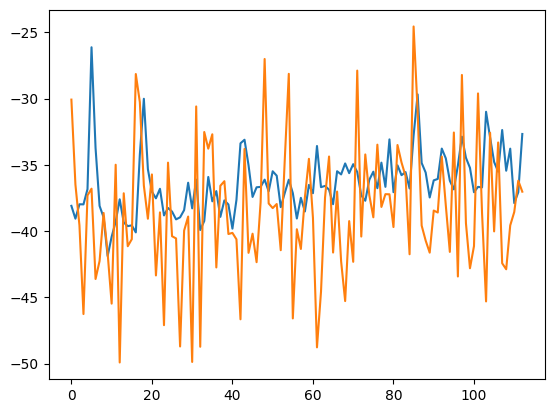

train_weighted_vae: enc
train: iter 0  trainloss -31.67810  validloss -30.30237±0.00000  bestvalidloss -30.30237  last_update 0
train: iter 1  trainloss -33.80650  validloss -20.05160±0.00000  bestvalidloss -30.30237  last_update 1
train: iter 2  trainloss -33.55117  validloss -30.20507±0.00000  bestvalidloss -30.30237  last_update 2
train: iter 3  trainloss -33.93117  validloss -29.76747±0.00000  bestvalidloss -30.30237  last_update 3
train: iter 4  trainloss -33.39491  validloss -36.76142±0.00000  bestvalidloss -36.76142  last_update 0
train: iter 5  trainloss -32.99857  validloss -31.53354±0.00000  bestvalidloss -36.76142  last_update 1
train: iter 6  trainloss -34.58095  validloss -39.69020±0.00000  bestvalidloss -39.69020  last_update 0
train: iter 7  trainloss -34.58967  validloss -36.82187±0.00000  bestvalidloss -39.69020  last_update 1
train: iter 8  trainloss -32.84637  validloss -32.22142±0.00000  bestvalidloss -39.69020  last_update 2
train: iter 9  trainloss -33.30992  vali

train: iter 78  trainloss -33.21245  validloss -30.80322±0.00000  bestvalidloss -42.90093  last_update 53
train: iter 79  trainloss -30.84946  validloss -15.66763±0.00000  bestvalidloss -42.90093  last_update 54
train: iter 80  trainloss -33.19916  validloss -37.66610±0.00000  bestvalidloss -42.90093  last_update 55
train: iter 81  trainloss -34.24996  validloss -30.23484±0.00000  bestvalidloss -42.90093  last_update 56
train: iter 82  trainloss -33.90397  validloss -36.31761±0.00000  bestvalidloss -42.90093  last_update 57
train: iter 83  trainloss -33.09070  validloss -33.66894±0.00000  bestvalidloss -42.90093  last_update 58
train: iter 84  trainloss -19.82046  validloss -30.99648±0.00000  bestvalidloss -42.90093  last_update 59
train: iter 85  trainloss -34.07438  validloss -32.04842±0.00000  bestvalidloss -42.90093  last_update 60
train: iter 86  trainloss -33.73084  validloss -32.93748±0.00000  bestvalidloss -42.90093  last_update 61
train: iter 87  trainloss -33.24912  validloss

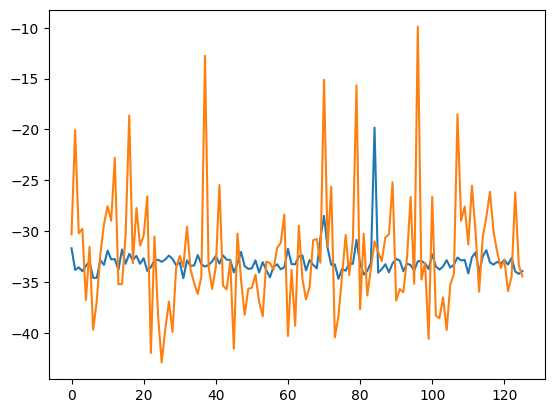

train_weighted_vae: dec
train: iter 0  trainloss -34.43074  validloss -33.25013±0.00000  bestvalidloss -33.25013  last_update 0
train: iter 1  trainloss -36.42957  validloss -35.11309±0.00000  bestvalidloss -35.11309  last_update 0
train: iter 2  trainloss -37.71604  validloss -38.53761±0.00000  bestvalidloss -38.53761  last_update 0
train: iter 3  trainloss -33.48697  validloss -38.84961±0.00000  bestvalidloss -38.84961  last_update 0
train: iter 4  trainloss -34.50080  validloss -35.28174±0.00000  bestvalidloss -38.84961  last_update 1
train: iter 5  trainloss -35.36648  validloss -38.84544±0.00000  bestvalidloss -38.84961  last_update 2
train: iter 6  trainloss -36.27981  validloss -40.38712±0.00000  bestvalidloss -40.38712  last_update 0
train: iter 7  trainloss -36.79517  validloss -33.91006±0.00000  bestvalidloss -40.38712  last_update 1
train: iter 8  trainloss -37.12756  validloss -38.87863±0.00000  bestvalidloss -40.38712  last_update 2
train: iter 9  trainloss -35.88482  vali

train: iter 80  trainloss -36.98765  validloss -38.88097±0.00000  bestvalidloss -43.56302  last_update 20
train: iter 81  trainloss -34.50889  validloss -33.84278±0.00000  bestvalidloss -43.56302  last_update 21
train: iter 82  trainloss -37.46720  validloss -38.68026±0.00000  bestvalidloss -43.56302  last_update 22
train: iter 83  trainloss -37.31049  validloss -35.11768±0.00000  bestvalidloss -43.56302  last_update 23
train: iter 84  trainloss -34.98130  validloss -40.94889±0.00000  bestvalidloss -43.56302  last_update 24
train: iter 85  trainloss -35.73633  validloss -32.39436±0.00000  bestvalidloss -43.56302  last_update 25
train: iter 86  trainloss -37.94269  validloss -39.49729±0.00000  bestvalidloss -43.56302  last_update 26
train: iter 87  trainloss -36.24939  validloss -34.65939±0.00000  bestvalidloss -43.56302  last_update 27
train: iter 88  trainloss -36.33083  validloss -37.38179±0.00000  bestvalidloss -43.56302  last_update 28
train: iter 89  trainloss -36.25509  validloss

train: iter 158  trainloss -35.80011  validloss -37.92252±0.00000  bestvalidloss -43.56302  last_update 98
train: iter 159  trainloss -35.30748  validloss -31.94589±0.00000  bestvalidloss -43.56302  last_update 99
train: iter 160  trainloss -37.25502  validloss -38.32348±0.00000  bestvalidloss -43.56302  last_update 100
train: fin


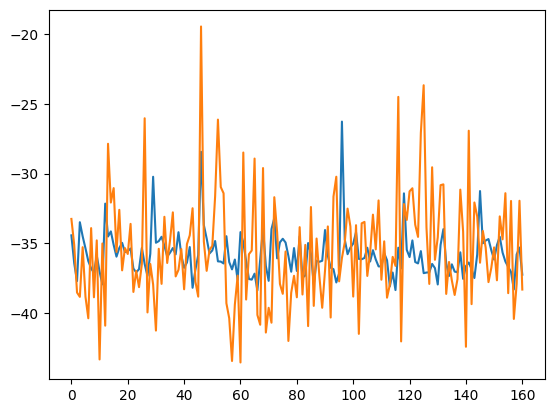

alpha 0.2 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

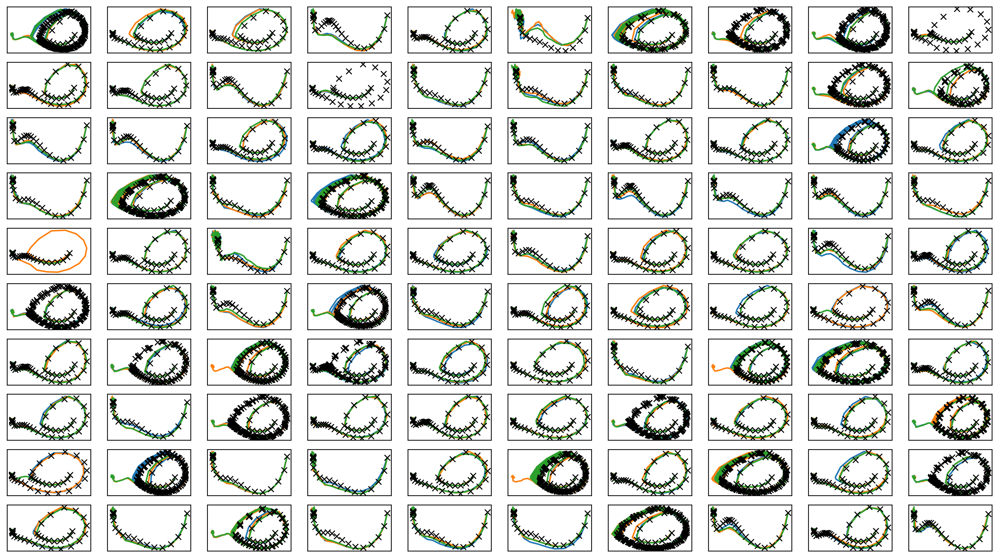

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

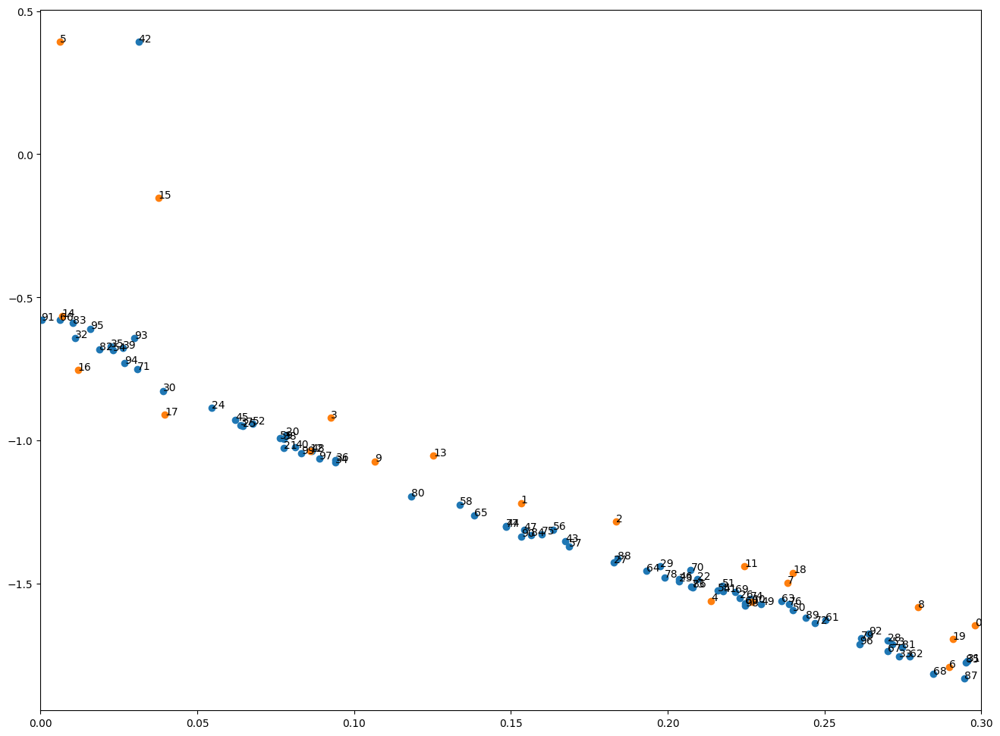

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-03-25 14:16:08.643868


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.07579  validloss 0.26113±0.00000  bestvalidloss 0.26113  last_update 0
train: iter 1  trainloss 0.05546  validloss 0.09018±0.00000  bestvalidloss 0.09018  last_update 0
train: iter 2  trainloss 0.04924  validloss 0.08147±0.00000  bestvalidloss 0.08147  last_update 0
train: iter 3  trainloss 0.04899  validloss 0.08129±0.00000  bestvalidloss 0.08129  last_update 0
train: iter 4  trainloss 0.04863  validloss 0.07669±0.00000  bestvalidloss 0.07669  last_update 0
train: iter 5  trainloss 0.04992  validloss 0.07959±0.00000  bestvalidloss 0.07669  last_update 1
train: iter 6  trainloss 0.04666  validloss 0.07452±0.00000  bestvalidloss 0.07452  last_update 0
train: iter 7  trainloss 0.04712  validloss 0.07560±0.00000  bestvalidloss 0.07452  last_update 1
train: iter 8  trainloss 0.04653  validloss 0.07659±0.00000  bestvalidloss 0.07452  last_update 2
train: iter 9  trainloss 0.04895  validloss 0.07328±0.00000  bestvalidloss 0.07328  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.04334  validloss 0.06870±0.00000  bestvalidloss 0.06856  last_update 7
train: iter 85  trainloss 0.04291  validloss 0.06849±0.00000  bestvalidloss 0.06849  last_update 0
train: iter 86  trainloss 0.04907  validloss 0.06966±0.00000  bestvalidloss 0.06849  last_update 1
train: iter 87  trainloss 0.04472  validloss 0.06991±0.00000  bestvalidloss 0.06849  last_update 2
train: iter 88  trainloss 0.04350  validloss 0.07687±0.00000  bestvalidloss 0.06849  last_update 3
train: iter 89  trainloss 0.04483  validloss 0.07918±0.00000  bestvalidloss 0.06849  last_update 4
train: iter 90  trainloss 0.05576  validloss 0.06869±0.00000  bestvalidloss 0.06849  last_update 5
train: iter 91  trainloss 0.04719  validloss 0.07608±0.00000  bestvalidloss 0.06849  last_update 6
train: iter 92  trainloss 0.04650  validloss 0.08034±0.00000  bestvalidloss 0.06849  last_update 7
train: iter 93  trainloss 0.08993  validloss 0.07374±0.00000  bestvalidloss 0.06849  last_update 8
train: ite

train: iter 167  trainloss 0.04113  validloss 0.06783±0.00000  bestvalidloss 0.06766  last_update 11
train: iter 168  trainloss 0.04154  validloss 0.06844±0.00000  bestvalidloss 0.06766  last_update 12
train: iter 169  trainloss 0.04105  validloss 0.06876±0.00000  bestvalidloss 0.06766  last_update 13
train: iter 170  trainloss 0.04209  validloss 0.07457±0.00000  bestvalidloss 0.06766  last_update 14
train: iter 171  trainloss 0.04150  validloss 0.06857±0.00000  bestvalidloss 0.06766  last_update 15
train: iter 172  trainloss 0.04049  validloss 0.07096±0.00000  bestvalidloss 0.06766  last_update 16
train: iter 173  trainloss 0.04127  validloss 0.06976±0.00000  bestvalidloss 0.06766  last_update 17
train: iter 174  trainloss 0.04128  validloss 0.07170±0.00000  bestvalidloss 0.06766  last_update 18
train: iter 175  trainloss 0.04385  validloss 0.07004±0.00000  bestvalidloss 0.06766  last_update 19
train: iter 176  trainloss 0.04135  validloss 0.07820±0.00000  bestvalidloss 0.06766  last_

train: iter 252  trainloss 0.03979  validloss 0.06789±0.00000  bestvalidloss 0.06764  last_update 65
train: iter 253  trainloss 0.03941  validloss 0.06826±0.00000  bestvalidloss 0.06764  last_update 66
train: iter 254  trainloss 0.04051  validloss 0.06975±0.00000  bestvalidloss 0.06764  last_update 67
train: iter 255  trainloss 0.04040  validloss 0.06872±0.00000  bestvalidloss 0.06764  last_update 68
train: iter 256  trainloss 0.03928  validloss 0.06855±0.00000  bestvalidloss 0.06764  last_update 69
train: iter 257  trainloss 0.04257  validloss 0.07139±0.00000  bestvalidloss 0.06764  last_update 70
train: iter 258  trainloss 0.04153  validloss 0.06998±0.00000  bestvalidloss 0.06764  last_update 71
train: iter 259  trainloss 0.04217  validloss 0.06878±0.00000  bestvalidloss 0.06764  last_update 72
train: iter 260  trainloss 0.04037  validloss 0.06827±0.00000  bestvalidloss 0.06764  last_update 73
train: iter 261  trainloss 0.03992  validloss 0.07725±0.00000  bestvalidloss 0.06764  last_

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -308.3708680379391
valid_loss:  -341.86470560312273
train_loss:  -51.9157830709219
valid_loss:  -42.34401485085487


1e-08 1000.0


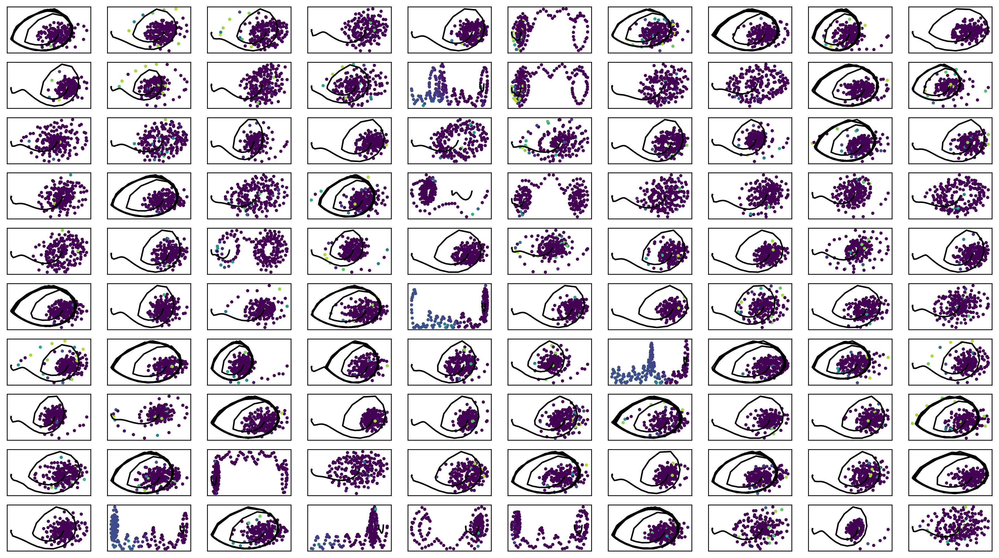

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -49.49874  validloss -44.96953±0.00000  bestvalidloss -44.96953  last_update 0
train: iter 1  trainloss -53.19556  validloss -46.81426±0.00000  bestvalidloss -46.81426  last_update 0
train: iter 2  trainloss -51.80619  validloss -45.84975±0.00000  bestvalidloss -46.81426  last_update 1
train: iter 3  trainloss -48.70095  validloss -49.86194±0.00000  bestvalidloss -49.86194  last_update 0
train: iter 4  trainloss -52.77622  validloss -47.39949±0.00000  bestvalidloss -49.86194  last_update 1
train: iter 5  trainloss -53.13684  validloss -43.17924±0.00000  bestvalidloss -49.86194  last_update 2
train: iter 6  trainloss -51.54790  validloss -46.49234±0.00000  bestvalidloss -49.86194  last_update 3
train: iter 7  trainloss -54.00074  validloss -52.70113±0.00000  bestvalidloss -52.70113  last_update 0
train: iter 8  trainloss -52.21064  validloss -46.44715±0.00000  bestvalidloss -52.70113  last_update 1
train: iter 9  trainloss -53.67600  

train: iter 79  trainloss -49.53658  validloss -54.71997±0.00000  bestvalidloss -59.84229  last_update 65
train: iter 80  trainloss -47.21604  validloss -27.66815±0.00000  bestvalidloss -59.84229  last_update 66
train: iter 81  trainloss -48.33648  validloss -51.68242±0.00000  bestvalidloss -59.84229  last_update 67
train: iter 82  trainloss -46.51206  validloss -53.57098±0.00000  bestvalidloss -59.84229  last_update 68
train: iter 83  trainloss -47.81929  validloss -50.87555±0.00000  bestvalidloss -59.84229  last_update 69
train: iter 84  trainloss -50.79609  validloss -48.73899±0.00000  bestvalidloss -59.84229  last_update 70
train: iter 85  trainloss -48.10700  validloss -47.38404±0.00000  bestvalidloss -59.84229  last_update 71
train: iter 86  trainloss -49.28722  validloss -42.80666±0.00000  bestvalidloss -59.84229  last_update 72
train: iter 87  trainloss -52.66161  validloss -52.58210±0.00000  bestvalidloss -59.84229  last_update 73
train: iter 88  trainloss -50.16801  validloss

train: iter 156  trainloss -45.92481  validloss -49.95088±0.00000  bestvalidloss -60.92610  last_update 50
train: iter 157  trainloss -46.98162  validloss -34.79893±0.00000  bestvalidloss -60.92610  last_update 51
train: iter 158  trainloss -47.60042  validloss -51.05026±0.00000  bestvalidloss -60.92610  last_update 52
train: iter 159  trainloss -49.08427  validloss -40.28481±0.00000  bestvalidloss -60.92610  last_update 53
train: iter 160  trainloss -49.49012  validloss -46.49422±0.00000  bestvalidloss -60.92610  last_update 54
train: iter 161  trainloss -49.84487  validloss -43.64390±0.00000  bestvalidloss -60.92610  last_update 55
train: iter 162  trainloss -48.01082  validloss -52.13059±0.00000  bestvalidloss -60.92610  last_update 56
train: iter 163  trainloss -39.71621  validloss -52.54366±0.00000  bestvalidloss -60.92610  last_update 57
train: iter 164  trainloss -46.65409  validloss -47.27548±0.00000  bestvalidloss -60.92610  last_update 58
train: iter 165  trainloss -49.74674 

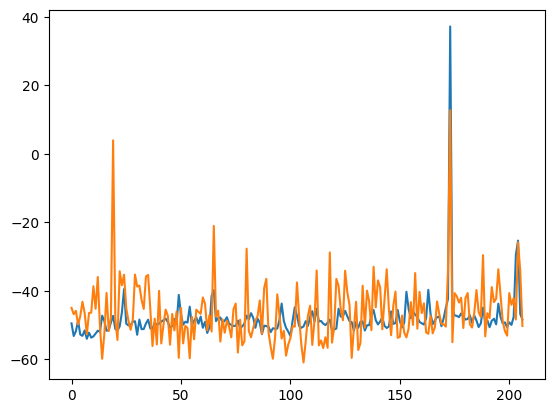

train_weighted_vae: enc
train: iter 0  trainloss -51.10557  validloss -49.91185±0.00000  bestvalidloss -49.91185  last_update 0
train: iter 1  trainloss -52.08955  validloss -44.74802±0.00000  bestvalidloss -49.91185  last_update 1
train: iter 2  trainloss -51.20593  validloss -51.16256±0.00000  bestvalidloss -51.16256  last_update 0
train: iter 3  trainloss -51.01589  validloss -44.04372±0.00000  bestvalidloss -51.16256  last_update 1
train: iter 4  trainloss -49.46853  validloss -37.03273±0.00000  bestvalidloss -51.16256  last_update 2
train: iter 5  trainloss -50.70520  validloss -49.49235±0.00000  bestvalidloss -51.16256  last_update 3
train: iter 6  trainloss -50.25733  validloss -40.71792±0.00000  bestvalidloss -51.16256  last_update 4
train: iter 7  trainloss -50.59374  validloss -50.57313±0.00000  bestvalidloss -51.16256  last_update 5
train: iter 8  trainloss -49.28639  validloss -40.08496±0.00000  bestvalidloss -51.16256  last_update 6
train: iter 9  trainloss -51.70127  vali

train: iter 78  trainloss -50.65008  validloss -46.97909±0.00000  bestvalidloss -58.90797  last_update 8
train: iter 79  trainloss -50.35884  validloss -53.11342±0.00000  bestvalidloss -58.90797  last_update 9
train: iter 80  trainloss -49.61214  validloss -46.50311±0.00000  bestvalidloss -58.90797  last_update 10
train: iter 81  trainloss -50.35858  validloss -49.29057±0.00000  bestvalidloss -58.90797  last_update 11
train: iter 82  trainloss -49.21103  validloss -42.80720±0.00000  bestvalidloss -58.90797  last_update 12
train: iter 83  trainloss -48.01383  validloss -49.92211±0.00000  bestvalidloss -58.90797  last_update 13
train: iter 84  trainloss -48.74767  validloss -42.80391±0.00000  bestvalidloss -58.90797  last_update 14
train: iter 85  trainloss -50.21503  validloss -52.18827±0.00000  bestvalidloss -58.90797  last_update 15
train: iter 86  trainloss -48.72493  validloss -52.59672±0.00000  bestvalidloss -58.90797  last_update 16
train: iter 87  trainloss -50.75788  validloss -

train: iter 155  trainloss -50.41169  validloss -40.28320±0.00000  bestvalidloss -59.02426  last_update 60
train: iter 156  trainloss -49.19865  validloss -43.35862±0.00000  bestvalidloss -59.02426  last_update 61
train: iter 157  trainloss -49.34246  validloss -46.78595±0.00000  bestvalidloss -59.02426  last_update 62
train: iter 158  trainloss -49.23497  validloss -48.73524±0.00000  bestvalidloss -59.02426  last_update 63
train: iter 159  trainloss -45.73510  validloss -51.08559±0.00000  bestvalidloss -59.02426  last_update 64
train: iter 160  trainloss -48.82265  validloss -44.24923±0.00000  bestvalidloss -59.02426  last_update 65
train: iter 161  trainloss -49.62200  validloss -39.80697±0.00000  bestvalidloss -59.02426  last_update 66
train: iter 162  trainloss -48.67626  validloss -42.09340±0.00000  bestvalidloss -59.02426  last_update 67
train: iter 163  trainloss -48.34358  validloss -44.25570±0.00000  bestvalidloss -59.02426  last_update 68
train: iter 164  trainloss -49.09195 

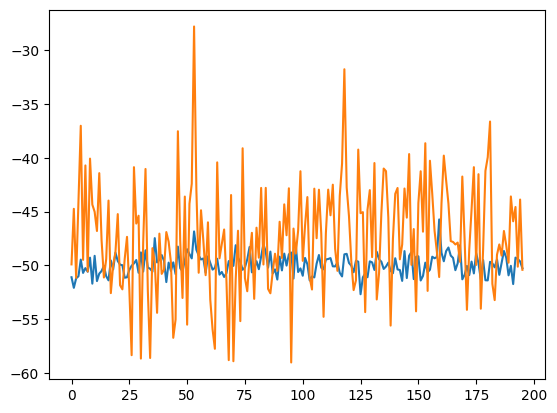

train_weighted_vae: dec
train: iter 0  trainloss -49.40401  validloss -47.53995±0.00000  bestvalidloss -47.53995  last_update 0
train: iter 1  trainloss -51.12638  validloss -44.28815±0.00000  bestvalidloss -47.53995  last_update 1
train: iter 2  trainloss -50.80800  validloss -44.01258±0.00000  bestvalidloss -47.53995  last_update 2
train: iter 3  trainloss -48.92972  validloss -47.24079±0.00000  bestvalidloss -47.53995  last_update 3
train: iter 4  trainloss -50.27521  validloss -29.55549±0.00000  bestvalidloss -47.53995  last_update 4
train: iter 5  trainloss -52.41866  validloss -40.18732±0.00000  bestvalidloss -47.53995  last_update 5
train: iter 6  trainloss -50.76175  validloss -42.57731±0.00000  bestvalidloss -47.53995  last_update 6
train: iter 7  trainloss -49.89446  validloss -41.27139±0.00000  bestvalidloss -47.53995  last_update 7
train: iter 8  trainloss -52.65988  validloss -30.13662±0.00000  bestvalidloss -47.53995  last_update 8
train: iter 9  trainloss -49.85107  vali

train: iter 78  trainloss -51.17787  validloss -41.55009±0.00000  bestvalidloss -54.62960  last_update 68
train: iter 79  trainloss -50.95296  validloss -46.83483±0.00000  bestvalidloss -54.62960  last_update 69
train: iter 80  trainloss -51.35845  validloss -40.43565±0.00000  bestvalidloss -54.62960  last_update 70
train: iter 81  trainloss -52.05563  validloss -45.09338±0.00000  bestvalidloss -54.62960  last_update 71
train: iter 82  trainloss -52.57275  validloss -45.60811±0.00000  bestvalidloss -54.62960  last_update 72
train: iter 83  trainloss -51.36563  validloss -31.47436±0.00000  bestvalidloss -54.62960  last_update 73
train: iter 84  trainloss -48.86700  validloss -30.87627±0.00000  bestvalidloss -54.62960  last_update 74
train: iter 85  trainloss -52.03526  validloss -45.26884±0.00000  bestvalidloss -54.62960  last_update 75
train: iter 86  trainloss -51.98737  validloss -36.19282±0.00000  bestvalidloss -54.62960  last_update 76
train: iter 87  trainloss -52.64829  validloss

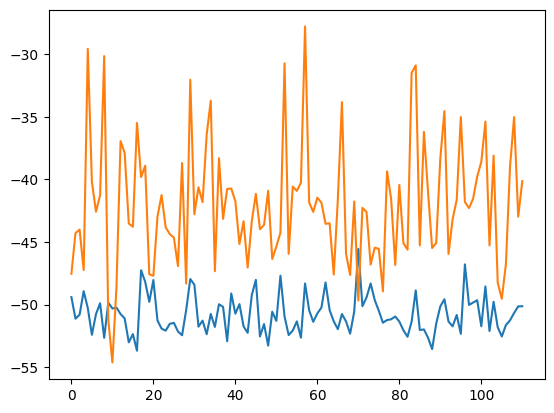

alpha 0.2 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

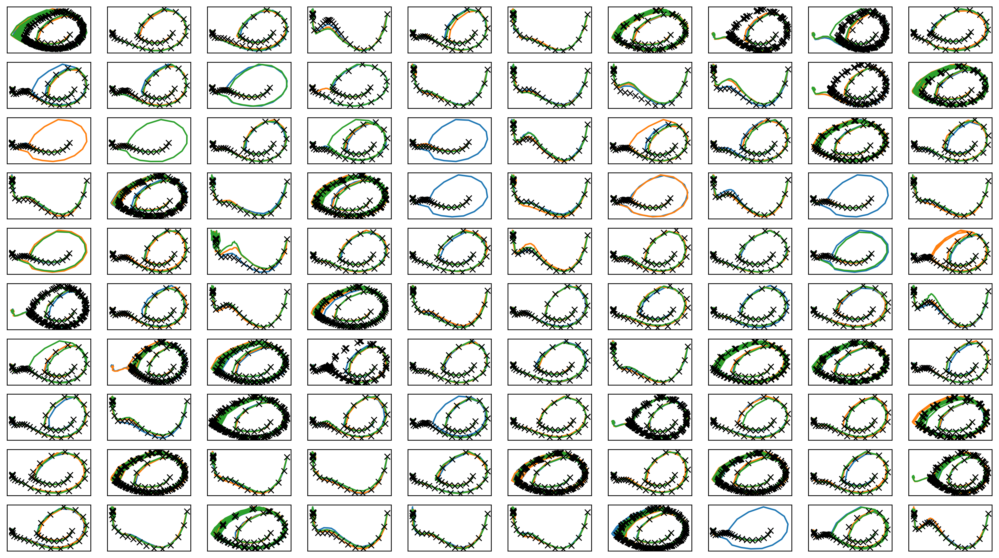

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

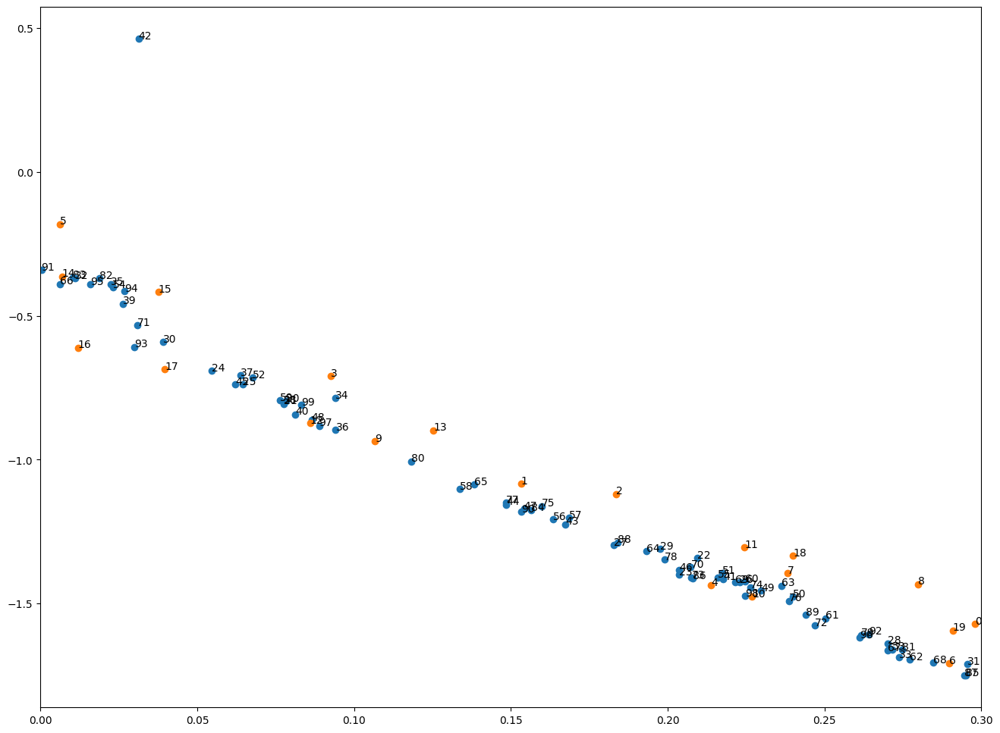

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-03-25 14:18:54.156006


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.12887  validloss 0.36505±0.00000  bestvalidloss 0.36505  last_update 0
train: iter 1  trainloss 0.08393  validloss 0.16084±0.00000  bestvalidloss 0.16084  last_update 0
train: iter 2  trainloss 0.08877  validloss 0.15522±0.00000  bestvalidloss 0.15522  last_update 0
train: iter 3  trainloss 0.07689  validloss 0.11403±0.00000  bestvalidloss 0.11403  last_update 0
train: iter 4  trainloss 0.07518  validloss 0.11767±0.00000  bestvalidloss 0.11403  last_update 1
train: iter 5  trainloss 0.07396  validloss 0.12020±0.00000  bestvalidloss 0.11403  last_update 2
train: iter 6  trainloss 0.07924  validloss 0.10833±0.00000  bestvalidloss 0.10833  last_update 0
train: iter 7  trainloss 0.07824  validloss 0.14996±0.00000  bestvalidloss 0.10833  last_update 1
train: iter 8  trainloss 0.06560  validloss 0.10884±0.00000  bestvalidloss 0.10833  last_update 2
train: iter 9  trainloss 0.06247  validloss 0.10466±0.00000  bestvalidloss 0.10466  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.06920  validloss 0.13220±0.00000  bestvalidloss 0.07263  last_update 4
train: iter 84  trainloss 0.05216  validloss 0.07819±0.00000  bestvalidloss 0.07263  last_update 5
train: iter 85  trainloss 0.05152  validloss 0.07503±0.00000  bestvalidloss 0.07263  last_update 6
train: iter 86  trainloss 0.05118  validloss 0.07284±0.00000  bestvalidloss 0.07263  last_update 7
train: iter 87  trainloss 0.05125  validloss 0.07603±0.00000  bestvalidloss 0.07263  last_update 8
train: iter 88  trainloss 0.05121  validloss 0.07345±0.00000  bestvalidloss 0.07263  last_update 9
train: iter 89  trainloss 0.05208  validloss 0.07551±0.00000  bestvalidloss 0.07263  last_update 10
train: iter 90  trainloss 0.05476  validloss 0.07147±0.00000  bestvalidloss 0.07147  last_update 0
train: iter 91  trainloss 0.05205  validloss 0.07349±0.00000  bestvalidloss 0.07147  last_update 1
train: iter 92  trainloss 0.05065  validloss 0.07370±0.00000  bestvalidloss 0.07147  last_update 2
train: it

train: iter 165  trainloss 0.04935  validloss 0.06954±0.00000  bestvalidloss 0.06717  last_update 10
train: iter 166  trainloss 0.04941  validloss 0.06869±0.00000  bestvalidloss 0.06717  last_update 11
train: iter 167  trainloss 0.04857  validloss 0.06991±0.00000  bestvalidloss 0.06717  last_update 12
train: iter 168  trainloss 0.05059  validloss 0.06928±0.00000  bestvalidloss 0.06717  last_update 13
train: iter 169  trainloss 0.05160  validloss 0.07199±0.00000  bestvalidloss 0.06717  last_update 14
train: iter 170  trainloss 0.05523  validloss 0.06964±0.00000  bestvalidloss 0.06717  last_update 15
train: iter 171  trainloss 0.08920  validloss 0.07512±0.00000  bestvalidloss 0.06717  last_update 16
train: iter 172  trainloss 0.05204  validloss 0.08172±0.00000  bestvalidloss 0.06717  last_update 17
train: iter 173  trainloss 0.04961  validloss 0.06792±0.00000  bestvalidloss 0.06717  last_update 18
train: iter 174  trainloss 0.04891  validloss 0.07001±0.00000  bestvalidloss 0.06717  last_

train: iter 249  trainloss 0.04798  validloss 0.06659±0.00000  bestvalidloss 0.06573  last_update 8
train: iter 250  trainloss 0.04805  validloss 0.06996±0.00000  bestvalidloss 0.06573  last_update 9
train: iter 251  trainloss 0.04884  validloss 0.06607±0.00000  bestvalidloss 0.06573  last_update 10
train: iter 252  trainloss 0.04867  validloss 0.06694±0.00000  bestvalidloss 0.06573  last_update 11
train: iter 253  trainloss 0.04814  validloss 0.06648±0.00000  bestvalidloss 0.06573  last_update 12
train: iter 254  trainloss 0.05054  validloss 0.06597±0.00000  bestvalidloss 0.06573  last_update 13
train: iter 255  trainloss 0.06536  validloss 0.06632±0.00000  bestvalidloss 0.06573  last_update 14
train: iter 256  trainloss 0.05980  validloss 0.09479±0.00000  bestvalidloss 0.06573  last_update 15
train: iter 257  trainloss 0.04870  validloss 0.06862±0.00000  bestvalidloss 0.06573  last_update 16
train: iter 258  trainloss 0.04771  validloss 0.06886±0.00000  bestvalidloss 0.06573  last_up

train: iter 333  trainloss 0.05027  validloss 0.06701±0.00000  bestvalidloss 0.06410  last_update 5
train: iter 334  trainloss 0.05194  validloss 0.06501±0.00000  bestvalidloss 0.06410  last_update 6
train: iter 335  trainloss 0.04947  validloss 0.06960±0.00000  bestvalidloss 0.06410  last_update 7
train: iter 336  trainloss 0.04649  validloss 0.06691±0.00000  bestvalidloss 0.06410  last_update 8
train: iter 337  trainloss 0.04661  validloss 0.06687±0.00000  bestvalidloss 0.06410  last_update 9
train: iter 338  trainloss 0.05417  validloss 0.06598±0.00000  bestvalidloss 0.06410  last_update 10
train: iter 339  trainloss 0.04837  validloss 0.06989±0.00000  bestvalidloss 0.06410  last_update 11
train: iter 340  trainloss 0.11716  validloss 0.06352±0.00000  bestvalidloss 0.06352  last_update 0
train: iter 341  trainloss 0.06439  validloss 0.10542±0.00000  bestvalidloss 0.06352  last_update 1
train: iter 342  trainloss 0.04716  validloss 0.06823±0.00000  bestvalidloss 0.06352  last_update 

train: iter 418  trainloss 0.04773  validloss 0.06577±0.00000  bestvalidloss 0.06311  last_update 49
train: iter 419  trainloss 0.04680  validloss 0.06393±0.00000  bestvalidloss 0.06311  last_update 50
train: iter 420  trainloss 0.04887  validloss 0.06580±0.00000  bestvalidloss 0.06311  last_update 51
train: iter 421  trainloss 0.04609  validloss 0.06566±0.00000  bestvalidloss 0.06311  last_update 52
train: iter 422  trainloss 0.07566  validloss 0.06374±0.00000  bestvalidloss 0.06311  last_update 53
train: iter 423  trainloss 0.08389  validloss 0.09961±0.00000  bestvalidloss 0.06311  last_update 54
train: iter 424  trainloss 0.04739  validloss 0.06872±0.00000  bestvalidloss 0.06311  last_update 55
train: iter 425  trainloss 0.04549  validloss 0.06553±0.00000  bestvalidloss 0.06311  last_update 56
train: iter 426  trainloss 0.04719  validloss 0.07330±0.00000  bestvalidloss 0.06311  last_update 57
train: iter 427  trainloss 0.04546  validloss 0.06507±0.00000  bestvalidloss 0.06311  last_

train: iter 503  trainloss 0.04588  validloss 0.06637±0.00000  bestvalidloss 0.06238  last_update 46
train: iter 504  trainloss 0.04736  validloss 0.06368±0.00000  bestvalidloss 0.06238  last_update 47
train: iter 505  trainloss 0.04534  validloss 0.06288±0.00000  bestvalidloss 0.06238  last_update 48
train: iter 506  trainloss 0.04549  validloss 0.06450±0.00000  bestvalidloss 0.06238  last_update 49
train: iter 507  trainloss 0.04560  validloss 0.06594±0.00000  bestvalidloss 0.06238  last_update 50
train: iter 508  trainloss 0.04622  validloss 0.06327±0.00000  bestvalidloss 0.06238  last_update 51
train: iter 509  trainloss 0.04459  validloss 0.06734±0.00000  bestvalidloss 0.06238  last_update 52
train: iter 510  trainloss 0.04363  validloss 0.06498±0.00000  bestvalidloss 0.06238  last_update 53
train: iter 511  trainloss 0.04485  validloss 0.06631±0.00000  bestvalidloss 0.06238  last_update 54
train: iter 512  trainloss 0.04595  validloss 0.06587±0.00000  bestvalidloss 0.06238  last_

train: iter 588  trainloss 0.04676  validloss 0.07226±0.00000  bestvalidloss 0.06163  last_update 46
train: iter 589  trainloss 0.04391  validloss 0.06310±0.00000  bestvalidloss 0.06163  last_update 47
train: iter 590  trainloss 0.04964  validloss 0.06696±0.00000  bestvalidloss 0.06163  last_update 48
train: iter 591  trainloss 0.06054  validloss 0.07229±0.00000  bestvalidloss 0.06163  last_update 49
train: iter 592  trainloss 0.04601  validloss 0.07071±0.00000  bestvalidloss 0.06163  last_update 50
train: iter 593  trainloss 0.04526  validloss 0.06727±0.00000  bestvalidloss 0.06163  last_update 51
train: iter 594  trainloss 0.04448  validloss 0.06491±0.00000  bestvalidloss 0.06163  last_update 52
train: iter 595  trainloss 0.04607  validloss 0.06581±0.00000  bestvalidloss 0.06163  last_update 53
train: iter 596  trainloss 0.04372  validloss 0.06380±0.00000  bestvalidloss 0.06163  last_update 54
train: iter 597  trainloss 0.04411  validloss 0.06356±0.00000  bestvalidloss 0.06163  last_

In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -179.411761598289
valid_loss:  -233.14843176484106
train_loss:  -46.40028015941381
valid_loss:  -42.393246221542356


1e-08 1000.0


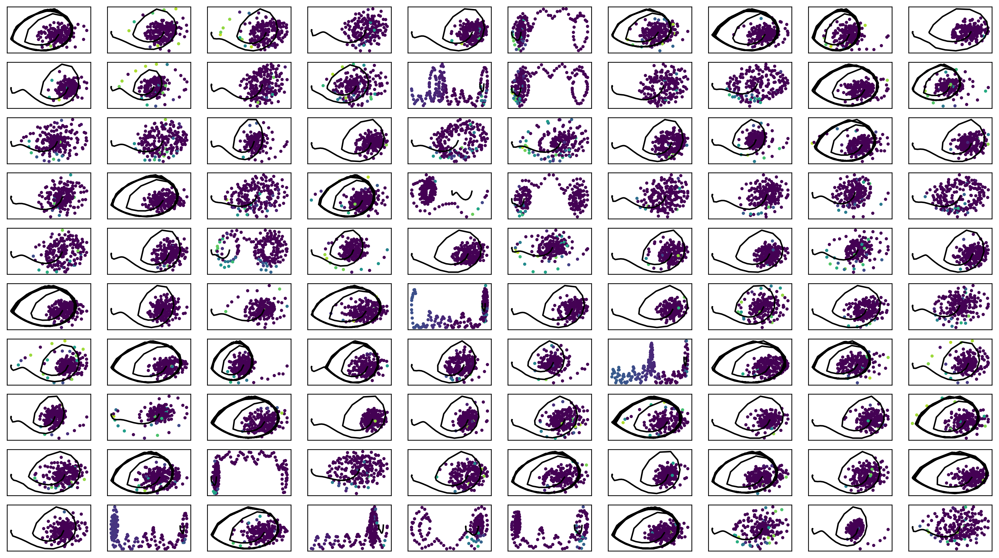

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -44.97811  validloss -43.49072±0.00000  bestvalidloss -43.49072  last_update 0
train: iter 1  trainloss -45.26505  validloss -50.10150±0.00000  bestvalidloss -50.10150  last_update 0
train: iter 2  trainloss -44.85215  validloss -37.36651±0.00000  bestvalidloss -50.10150  last_update 1
train: iter 3  trainloss -45.54678  validloss -34.37393±0.00000  bestvalidloss -50.10150  last_update 2
train: iter 4  trainloss -45.45501  validloss -45.54657±0.00000  bestvalidloss -50.10150  last_update 3
train: iter 5  trainloss -45.10766  validloss -43.47097±0.00000  bestvalidloss -50.10150  last_update 4
train: iter 6  trainloss -44.49775  validloss -45.29837±0.00000  bestvalidloss -50.10150  last_update 5
train: iter 7  trainloss -43.61414  validloss -48.28973±0.00000  bestvalidloss -50.10150  last_update 6
train: iter 8  trainloss -45.91685  validloss -32.30823±0.00000  bestvalidloss -50.10150  last_update 7
train: iter 9  trainloss -42.96240  

train: iter 78  trainloss -48.02891  validloss -52.24622±0.00000  bestvalidloss -66.50506  last_update 3
train: iter 79  trainloss -47.14916  validloss -43.97993±0.00000  bestvalidloss -66.50506  last_update 4
train: iter 80  trainloss -45.58603  validloss -46.84658±0.00000  bestvalidloss -66.50506  last_update 5
train: iter 81  trainloss -45.55591  validloss -53.06793±0.00000  bestvalidloss -66.50506  last_update 6
train: iter 82  trainloss -47.06590  validloss -55.52970±0.00000  bestvalidloss -66.50506  last_update 7
train: iter 83  trainloss -47.24427  validloss -45.52075±0.00000  bestvalidloss -66.50506  last_update 8
train: iter 84  trainloss -44.97106  validloss -51.87521±0.00000  bestvalidloss -66.50506  last_update 9
train: iter 85  trainloss -43.25767  validloss -52.84529±0.00000  bestvalidloss -66.50506  last_update 10
train: iter 86  trainloss -44.47217  validloss -44.65976±0.00000  bestvalidloss -66.50506  last_update 11
train: iter 87  trainloss -43.55280  validloss -41.38

train: iter 156  trainloss -40.18233  validloss -37.95248±0.00000  bestvalidloss -66.50506  last_update 81
train: iter 157  trainloss -41.24523  validloss -51.96031±0.00000  bestvalidloss -66.50506  last_update 82
train: iter 158  trainloss -42.50092  validloss -53.55675±0.00000  bestvalidloss -66.50506  last_update 83
train: iter 159  trainloss -39.78812  validloss -45.76310±0.00000  bestvalidloss -66.50506  last_update 84
train: iter 160  trainloss -42.30079  validloss -51.61811±0.00000  bestvalidloss -66.50506  last_update 85
train: iter 161  trainloss -42.24815  validloss -32.53143±0.00000  bestvalidloss -66.50506  last_update 86
train: iter 162  trainloss -42.85447  validloss -51.96380±0.00000  bestvalidloss -66.50506  last_update 87
train: iter 163  trainloss -44.00697  validloss -48.49248±0.00000  bestvalidloss -66.50506  last_update 88
train: iter 164  trainloss -41.26107  validloss -42.61134±0.00000  bestvalidloss -66.50506  last_update 89
train: iter 165  trainloss -44.07971 

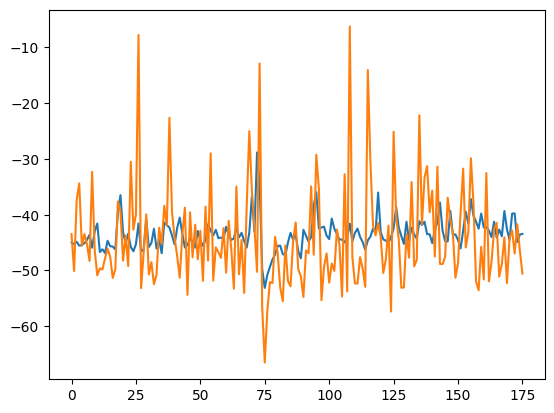

train_weighted_vae: enc
train: iter 0  trainloss -45.82091  validloss -31.90776±0.00000  bestvalidloss -31.90776  last_update 0
train: iter 1  trainloss -44.37495  validloss -38.91970±0.00000  bestvalidloss -38.91970  last_update 0
train: iter 2  trainloss -45.24566  validloss -54.74766±0.00000  bestvalidloss -54.74766  last_update 0
train: iter 3  trainloss -43.33868  validloss -58.58313±0.00000  bestvalidloss -58.58313  last_update 0
train: iter 4  trainloss -44.96412  validloss -46.92417±0.00000  bestvalidloss -58.58313  last_update 1
train: iter 5  trainloss -44.97070  validloss -52.59203±0.00000  bestvalidloss -58.58313  last_update 2
train: iter 6  trainloss -45.19266  validloss -41.31179±0.00000  bestvalidloss -58.58313  last_update 3
train: iter 7  trainloss -44.63910  validloss -51.79341±0.00000  bestvalidloss -58.58313  last_update 4
train: iter 8  trainloss -45.02209  validloss -42.89853±0.00000  bestvalidloss -58.58313  last_update 5
train: iter 9  trainloss -43.45950  vali

train: iter 78  trainloss -46.14856  validloss -47.10153±0.00000  bestvalidloss -58.58313  last_update 75
train: iter 79  trainloss -44.18414  validloss -46.62243±0.00000  bestvalidloss -58.58313  last_update 76
train: iter 80  trainloss -44.40902  validloss -49.16720±0.00000  bestvalidloss -58.58313  last_update 77
train: iter 81  trainloss -44.31402  validloss -49.10807±0.00000  bestvalidloss -58.58313  last_update 78
train: iter 82  trainloss -44.82241  validloss -49.21100±0.00000  bestvalidloss -58.58313  last_update 79
train: iter 83  trainloss -45.43419  validloss -47.27206±0.00000  bestvalidloss -58.58313  last_update 80
train: iter 84  trainloss -44.61914  validloss -45.43475±0.00000  bestvalidloss -58.58313  last_update 81
train: iter 85  trainloss -44.21031  validloss -53.79557±0.00000  bestvalidloss -58.58313  last_update 82
train: iter 86  trainloss -44.38752  validloss -44.09895±0.00000  bestvalidloss -58.58313  last_update 83
train: iter 87  trainloss -44.40671  validloss

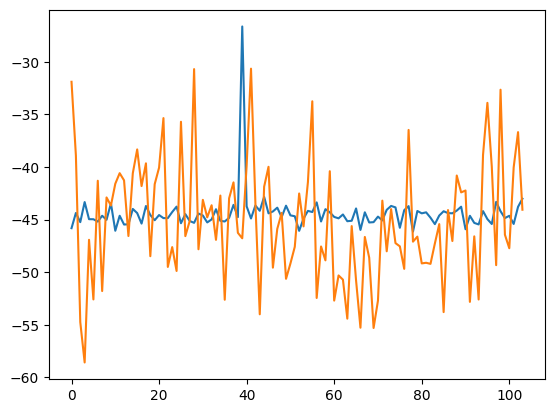

train_weighted_vae: dec
train: iter 0  trainloss -43.59789  validloss -46.91810±0.00000  bestvalidloss -46.91810  last_update 0
train: iter 1  trainloss -43.41647  validloss -43.52355±0.00000  bestvalidloss -46.91810  last_update 1
train: iter 2  trainloss -42.15410  validloss -50.75620±0.00000  bestvalidloss -50.75620  last_update 0
train: iter 3  trainloss -38.30621  validloss -42.53091±0.00000  bestvalidloss -50.75620  last_update 1
train: iter 4  trainloss -19.02656  validloss -35.93330±0.00000  bestvalidloss -50.75620  last_update 2
train: iter 5  trainloss -31.37367  validloss -47.27254±0.00000  bestvalidloss -50.75620  last_update 3
train: iter 6  trainloss -40.34617  validloss -49.39400±0.00000  bestvalidloss -50.75620  last_update 4
train: iter 7  trainloss -40.01579  validloss -58.63786±0.00000  bestvalidloss -58.63786  last_update 0
train: iter 8  trainloss -42.55601  validloss -55.30947±0.00000  bestvalidloss -58.63786  last_update 1
train: iter 9  trainloss -42.85206  vali

train: iter 78  trainloss -42.76896  validloss -52.51554±0.00000  bestvalidloss -60.31388  last_update 66
train: iter 79  trainloss -42.44521  validloss -49.39042±0.00000  bestvalidloss -60.31388  last_update 67
train: iter 80  trainloss -39.86305  validloss -53.25395±0.00000  bestvalidloss -60.31388  last_update 68
train: iter 81  trainloss -40.39507  validloss -41.45990±0.00000  bestvalidloss -60.31388  last_update 69
train: iter 82  trainloss -33.48053  validloss -53.57178±0.00000  bestvalidloss -60.31388  last_update 70
train: iter 83  trainloss -42.06411  validloss -50.52837±0.00000  bestvalidloss -60.31388  last_update 71
train: iter 84  trainloss -42.45156  validloss -45.54469±0.00000  bestvalidloss -60.31388  last_update 72
train: iter 85  trainloss -41.22171  validloss -47.55021±0.00000  bestvalidloss -60.31388  last_update 73
train: iter 86  trainloss -43.09647  validloss -52.29200±0.00000  bestvalidloss -60.31388  last_update 74
train: iter 87  trainloss -42.90839  validloss

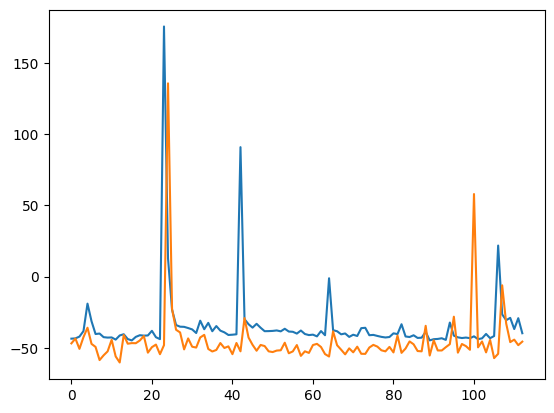

alpha 0.2 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

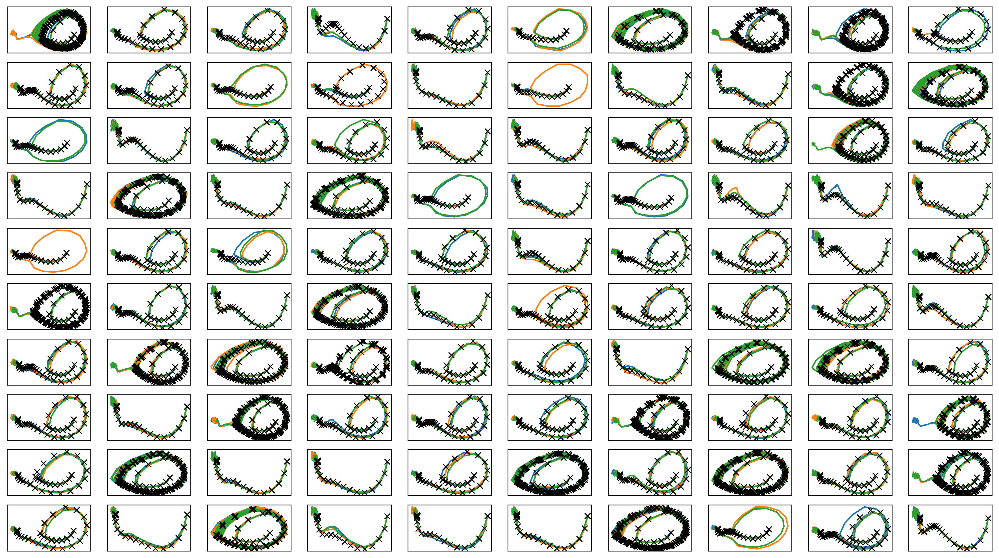

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

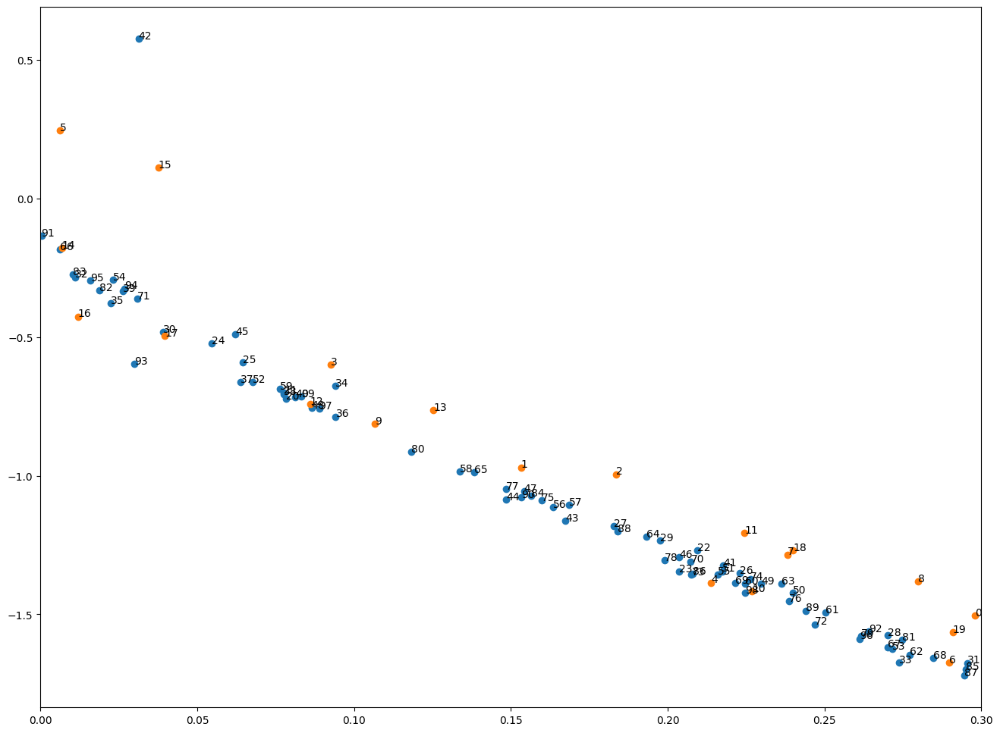

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-03-25 14:21:20.744764


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.10055  validloss 0.45221±0.00000  bestvalidloss 0.45221  last_update 0
train: iter 1  trainloss 0.06650  validloss 0.12212±0.00000  bestvalidloss 0.12212  last_update 0
train: iter 2  trainloss 0.06400  validloss 0.10995±0.00000  bestvalidloss 0.10995  last_update 0
train: iter 3  trainloss 0.06131  validloss 0.10733±0.00000  bestvalidloss 0.10733  last_update 0
train: iter 4  trainloss 0.06311  validloss 0.10996±0.00000  bestvalidloss 0.10733  last_update 1
train: iter 5  trainloss 0.06398  validloss 0.11366±0.00000  bestvalidloss 0.10733  last_update 2
train: iter 6  trainloss 0.06019  validloss 0.10448±0.00000  bestvalidloss 0.10448  last_update 0
train: iter 7  trainloss 0.05859  validloss 0.10742±0.00000  bestvalidloss 0.10448  last_update 1
train: iter 8  trainloss 0.05908  validloss 0.10626±0.00000  bestvalidloss 0.10448  last_update 2
train: iter 9  trainloss 0.06016  validloss 0.10718±0.00000  bestvalidloss 0.10448  last_update 3
train: iter 10  trai

train: iter 83  trainloss 0.06513  validloss 0.17098±0.00000  bestvalidloss 0.10291  last_update 10
train: iter 84  trainloss 0.04814  validloss 0.10497±0.00000  bestvalidloss 0.10291  last_update 11
train: iter 85  trainloss 0.04806  validloss 0.10655±0.00000  bestvalidloss 0.10291  last_update 12
train: iter 86  trainloss 0.04787  validloss 0.10576±0.00000  bestvalidloss 0.10291  last_update 13
train: iter 87  trainloss 0.04732  validloss 0.10532±0.00000  bestvalidloss 0.10291  last_update 14
train: iter 88  trainloss 0.04765  validloss 0.10640±0.00000  bestvalidloss 0.10291  last_update 15
train: iter 89  trainloss 0.04979  validloss 0.10497±0.00000  bestvalidloss 0.10291  last_update 16
train: iter 90  trainloss 0.04785  validloss 0.10524±0.00000  bestvalidloss 0.10291  last_update 17
train: iter 91  trainloss 0.04729  validloss 0.10643±0.00000  bestvalidloss 0.10291  last_update 18
train: iter 92  trainloss 0.04774  validloss 0.10505±0.00000  bestvalidloss 0.10291  last_update 19


train: iter 167  trainloss 0.04539  validloss 0.09999±0.00000  bestvalidloss 0.09931  last_update 5
train: iter 168  trainloss 0.04549  validloss 0.09998±0.00000  bestvalidloss 0.09931  last_update 6
train: iter 169  trainloss 0.04594  validloss 0.10038±0.00000  bestvalidloss 0.09931  last_update 7
train: iter 170  trainloss 0.04556  validloss 0.10192±0.00000  bestvalidloss 0.09931  last_update 8
train: iter 171  trainloss 0.04491  validloss 0.10142±0.00000  bestvalidloss 0.09931  last_update 9
train: iter 172  trainloss 0.04947  validloss 0.09914±0.00000  bestvalidloss 0.09914  last_update 0
train: iter 173  trainloss 0.05059  validloss 0.11428±0.00000  bestvalidloss 0.09914  last_update 1
train: iter 174  trainloss 0.04965  validloss 0.10757±0.00000  bestvalidloss 0.09914  last_update 2
train: iter 175  trainloss 0.04832  validloss 0.09872±0.00000  bestvalidloss 0.09872  last_update 0
train: iter 176  trainloss 0.04650  validloss 0.10200±0.00000  bestvalidloss 0.09872  last_update 1


train: iter 250  trainloss 0.04423  validloss 0.10146±0.00000  bestvalidloss 0.09731  last_update 45
train: iter 251  trainloss 0.04460  validloss 0.10534±0.00000  bestvalidloss 0.09731  last_update 46
train: iter 252  trainloss 0.04446  validloss 0.09959±0.00000  bestvalidloss 0.09731  last_update 47
train: iter 253  trainloss 0.04370  validloss 0.09952±0.00000  bestvalidloss 0.09731  last_update 48
train: iter 254  trainloss 0.04496  validloss 0.10049±0.00000  bestvalidloss 0.09731  last_update 49
train: iter 255  trainloss 0.04460  validloss 0.09945±0.00000  bestvalidloss 0.09731  last_update 50
train: iter 256  trainloss 0.04383  validloss 0.09997±0.00000  bestvalidloss 0.09731  last_update 51
train: iter 257  trainloss 0.04517  validloss 0.10269±0.00000  bestvalidloss 0.09731  last_update 52
train: iter 258  trainloss 0.04342  validloss 0.10405±0.00000  bestvalidloss 0.09731  last_update 53
train: iter 259  trainloss 0.04549  validloss 0.09984±0.00000  bestvalidloss 0.09731  last_

In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -156.54646659106012
valid_loss:  -457.820669092536
train_loss:  -43.44788928002119
valid_loss:  -61.164509502649295


1e-08 1000.0


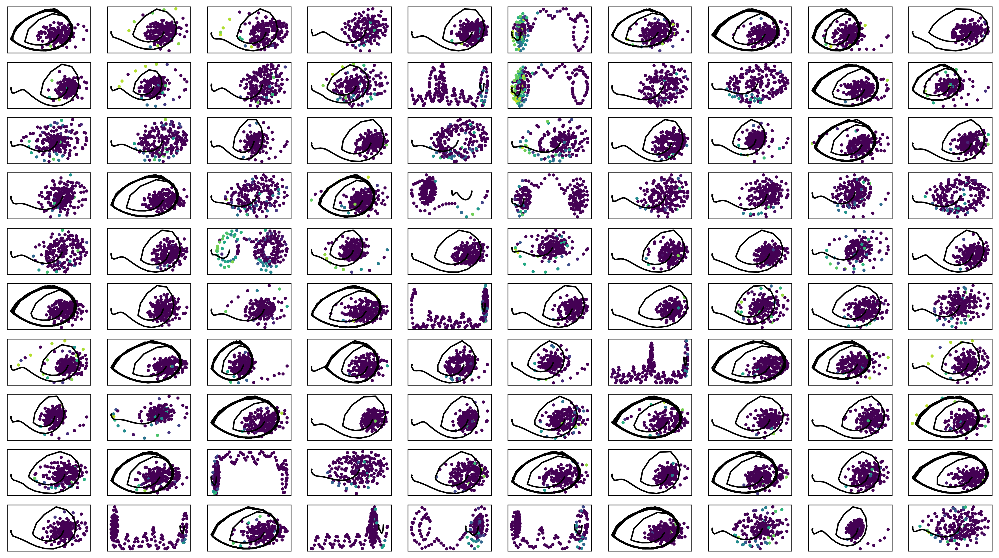

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -43.40676  validloss -56.41874±0.00000  bestvalidloss -56.41874  last_update 0
train: iter 1  trainloss -46.89661  validloss -46.80802±0.00000  bestvalidloss -56.41874  last_update 1
train: iter 2  trainloss -49.28367  validloss -46.70400±0.00000  bestvalidloss -56.41874  last_update 2
train: iter 3  trainloss -45.60539  validloss -40.73942±0.00000  bestvalidloss -56.41874  last_update 3
train: iter 4  trainloss -47.64507  validloss -50.44252±0.00000  bestvalidloss -56.41874  last_update 4
train: iter 5  trainloss -47.87682  validloss -50.01893±0.00000  bestvalidloss -56.41874  last_update 5
train: iter 6  trainloss -46.82792  validloss -71.05031±0.00000  bestvalidloss -71.05031  last_update 0
train: iter 7  trainloss -49.43612  validloss -42.23385±0.00000  bestvalidloss -71.05031  last_update 1
train: iter 8  trainloss -47.13686  validloss -58.47523±0.00000  bestvalidloss -71.05031  last_update 2
train: iter 9  trainloss -47.09258  

train: iter 78  trainloss -46.23705  validloss -50.42885±0.00000  bestvalidloss -75.40796  last_update 63
train: iter 79  trainloss -49.14475  validloss -47.60499±0.00000  bestvalidloss -75.40796  last_update 64
train: iter 80  trainloss -46.08856  validloss -35.30622±0.00000  bestvalidloss -75.40796  last_update 65
train: iter 81  trainloss -47.15200  validloss -49.30689±0.00000  bestvalidloss -75.40796  last_update 66
train: iter 82  trainloss -43.28761  validloss -32.94890±0.00000  bestvalidloss -75.40796  last_update 67
train: iter 83  trainloss -47.43726  validloss -43.18202±0.00000  bestvalidloss -75.40796  last_update 68
train: iter 84  trainloss -46.66879  validloss -49.28758±0.00000  bestvalidloss -75.40796  last_update 69
train: iter 85  trainloss -44.90373  validloss -37.74115±0.00000  bestvalidloss -75.40796  last_update 70
train: iter 86  trainloss -46.06242  validloss -50.58689±0.00000  bestvalidloss -75.40796  last_update 71
train: iter 87  trainloss -44.71849  validloss

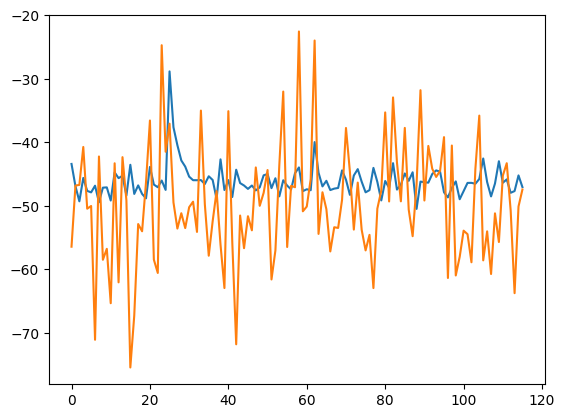

train_weighted_vae: enc
train: iter 0  trainloss -47.63125  validloss -46.05744±0.00000  bestvalidloss -46.05744  last_update 0
train: iter 1  trainloss -48.31214  validloss -49.60812±0.00000  bestvalidloss -49.60812  last_update 0
train: iter 2  trainloss -47.66941  validloss -47.54194±0.00000  bestvalidloss -49.60812  last_update 1
train: iter 3  trainloss -48.05794  validloss -45.34819±0.00000  bestvalidloss -49.60812  last_update 2
train: iter 4  trainloss -48.24259  validloss -48.78001±0.00000  bestvalidloss -49.60812  last_update 3
train: iter 5  trainloss -48.31307  validloss -45.19024±0.00000  bestvalidloss -49.60812  last_update 4
train: iter 6  trainloss -48.01854  validloss -46.12722±0.00000  bestvalidloss -49.60812  last_update 5
train: iter 7  trainloss -48.54698  validloss -53.96546±0.00000  bestvalidloss -53.96546  last_update 0
train: iter 8  trainloss -47.73804  validloss -52.30923±0.00000  bestvalidloss -53.96546  last_update 1
train: iter 9  trainloss -48.14742  vali

train: iter 78  trainloss -47.48717  validloss -48.26901±0.00000  bestvalidloss -71.10550  last_update 5
train: iter 79  trainloss -47.77918  validloss -55.66497±0.00000  bestvalidloss -71.10550  last_update 6
train: iter 80  trainloss -47.87937  validloss -49.63090±0.00000  bestvalidloss -71.10550  last_update 7
train: iter 81  trainloss -50.20365  validloss -58.45605±0.00000  bestvalidloss -71.10550  last_update 8
train: iter 82  trainloss -48.98046  validloss -62.32029±0.00000  bestvalidloss -71.10550  last_update 9
train: iter 83  trainloss -48.96173  validloss -51.37792±0.00000  bestvalidloss -71.10550  last_update 10
train: iter 84  trainloss -50.29862  validloss -61.33936±0.00000  bestvalidloss -71.10550  last_update 11
train: iter 85  trainloss -51.51399  validloss -60.28900±0.00000  bestvalidloss -71.10550  last_update 12
train: iter 86  trainloss -47.55634  validloss -52.74903±0.00000  bestvalidloss -71.10550  last_update 13
train: iter 87  trainloss -49.91720  validloss -59.

train: iter 156  trainloss -50.07637  validloss -52.84220±0.00000  bestvalidloss -71.10550  last_update 83
train: iter 157  trainloss -49.34339  validloss -52.23430±0.00000  bestvalidloss -71.10550  last_update 84
train: iter 158  trainloss -48.89849  validloss -53.89072±0.00000  bestvalidloss -71.10550  last_update 85
train: iter 159  trainloss -48.76042  validloss -35.17767±0.00000  bestvalidloss -71.10550  last_update 86
train: iter 160  trainloss -48.82365  validloss -48.60746±0.00000  bestvalidloss -71.10550  last_update 87
train: iter 161  trainloss -49.81164  validloss -56.41171±0.00000  bestvalidloss -71.10550  last_update 88
train: iter 162  trainloss -49.15427  validloss -51.64645±0.00000  bestvalidloss -71.10550  last_update 89
train: iter 163  trainloss -49.30045  validloss -41.83994±0.00000  bestvalidloss -71.10550  last_update 90
train: iter 164  trainloss -46.65103  validloss -45.75508±0.00000  bestvalidloss -71.10550  last_update 91
train: iter 165  trainloss -46.61140 

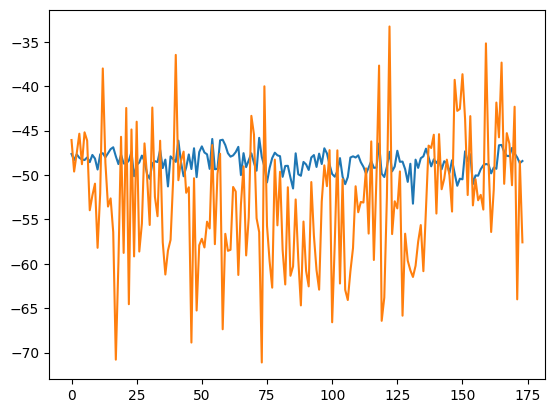

train_weighted_vae: dec
train: iter 0  trainloss -49.60248  validloss -58.25183±0.00000  bestvalidloss -58.25183  last_update 0
train: iter 1  trainloss -50.48394  validloss -56.63355±0.00000  bestvalidloss -58.25183  last_update 1
train: iter 2  trainloss -50.50381  validloss -45.57397±0.00000  bestvalidloss -58.25183  last_update 2
train: iter 3  trainloss -49.43672  validloss -57.33323±0.00000  bestvalidloss -58.25183  last_update 3
train: iter 4  trainloss -49.67872  validloss -47.79205±0.00000  bestvalidloss -58.25183  last_update 4
train: iter 5  trainloss -51.52541  validloss -60.18921±0.00000  bestvalidloss -60.18921  last_update 0
train: iter 6  trainloss -49.79767  validloss -53.70910±0.00000  bestvalidloss -60.18921  last_update 1
train: iter 7  trainloss -50.12442  validloss -52.12074±0.00000  bestvalidloss -60.18921  last_update 2
train: iter 8  trainloss -50.02384  validloss -55.83755±0.00000  bestvalidloss -60.18921  last_update 3
train: iter 9  trainloss -51.37019  vali

train: iter 78  trainloss -51.45302  validloss -43.66335±0.00000  bestvalidloss -63.74593  last_update 54
train: iter 79  trainloss -49.64780  validloss -51.12747±0.00000  bestvalidloss -63.74593  last_update 55
train: iter 80  trainloss -51.99587  validloss -59.46133±0.00000  bestvalidloss -63.74593  last_update 56
train: iter 81  trainloss -49.04984  validloss -57.38334±0.00000  bestvalidloss -63.74593  last_update 57
train: iter 82  trainloss -51.83819  validloss -57.13284±0.00000  bestvalidloss -63.74593  last_update 58
train: iter 83  trainloss -50.12688  validloss -43.76068±0.00000  bestvalidloss -63.74593  last_update 59
train: iter 84  trainloss -52.72589  validloss -52.47770±0.00000  bestvalidloss -63.74593  last_update 60
train: iter 85  trainloss -49.77153  validloss -52.40962±0.00000  bestvalidloss -63.74593  last_update 61
train: iter 86  trainloss -51.27305  validloss -54.79431±0.00000  bestvalidloss -63.74593  last_update 62
train: iter 87  trainloss -51.99464  validloss

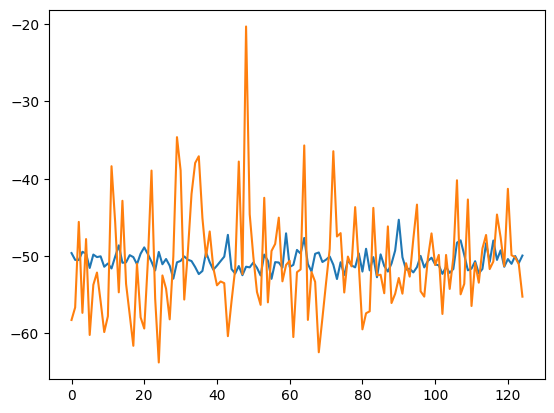

alpha 0.2 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

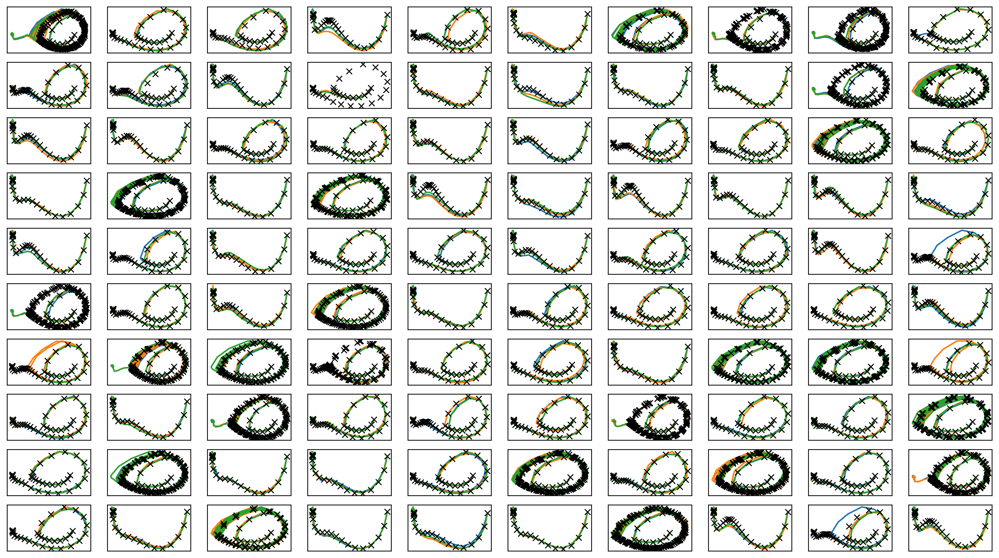

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

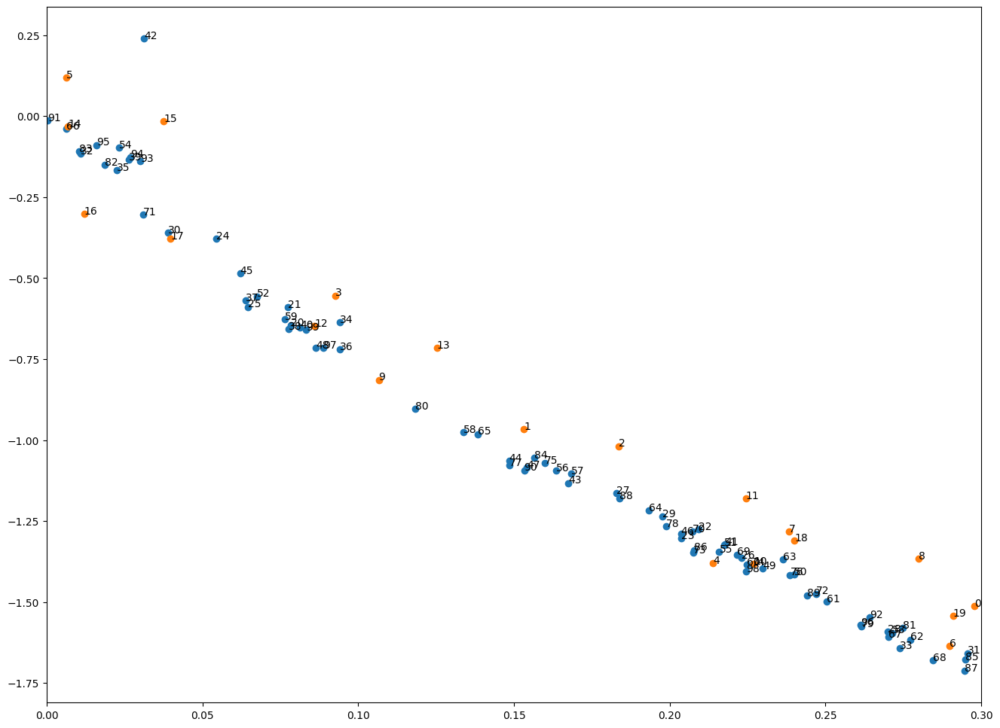

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-03-25 14:23:27.324105


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.04372  validloss 0.07999±0.00000  bestvalidloss 0.07999  last_update 0
train: iter 1  trainloss 0.04371  validloss 0.07567±0.00000  bestvalidloss 0.07567  last_update 0
train: iter 2  trainloss 0.04067  validloss 0.07386±0.00000  bestvalidloss 0.07386  last_update 0
train: iter 3  trainloss 0.03992  validloss 0.07167±0.00000  bestvalidloss 0.07167  last_update 0
train: iter 4  trainloss 0.04043  validloss 0.08031±0.00000  bestvalidloss 0.07167  last_update 1
train: iter 5  trainloss 0.03972  validloss 0.07146±0.00000  bestvalidloss 0.07146  last_update 0
train: iter 6  trainloss 0.03840  validloss 0.07034±0.00000  bestvalidloss 0.07034  last_update 0
train: iter 7  trainloss 0.03791  validloss 0.07079±0.00000  bestvalidloss 0.07034  last_update 1
train: iter 8  trainloss 0.03922  validloss 0.07329±0.00000  bestvalidloss 0.07034  last_update 2
train: iter 9  trainloss 0.05809  validloss 0.06983±0.00000  bestvalidloss 0.06983  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.04357  validloss 0.06649±0.00000  bestvalidloss 0.06479  last_update 52
train: iter 85  trainloss 0.03515  validloss 0.06777±0.00000  bestvalidloss 0.06479  last_update 53
train: iter 86  trainloss 0.03448  validloss 0.06714±0.00000  bestvalidloss 0.06479  last_update 54
train: iter 87  trainloss 0.03491  validloss 0.06679±0.00000  bestvalidloss 0.06479  last_update 55
train: iter 88  trainloss 0.03537  validloss 0.06666±0.00000  bestvalidloss 0.06479  last_update 56
train: iter 89  trainloss 0.03496  validloss 0.06659±0.00000  bestvalidloss 0.06479  last_update 57
train: iter 90  trainloss 0.07661  validloss 0.07452±0.00000  bestvalidloss 0.06479  last_update 58
train: iter 91  trainloss 0.04204  validloss 0.09263±0.00000  bestvalidloss 0.06479  last_update 59
train: iter 92  trainloss 0.03528  validloss 0.06934±0.00000  bestvalidloss 0.06479  last_update 60
train: iter 93  trainloss 0.03431  validloss 0.06702±0.00000  bestvalidloss 0.06479  last_update 61


In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -183.2608097913861
valid_loss:  -238.8188119745254
train_loss:  -41.76110943377019
valid_loss:  -38.098099982738496


In [66]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


train: iter 0  trainloss 9.16113  validloss 10.38635±0.00000  bestvalidloss 10.38635  last_update 0
train: iter 1  trainloss 8.20093  validloss 9.24754±0.00000  bestvalidloss 9.24754  last_update 0
train: iter 2  trainloss 7.40140  validloss 8.27646±0.00000  bestvalidloss 8.27646  last_update 0
train: iter 3  trainloss 6.73885  validloss 7.50020±0.00000  bestvalidloss 7.50020  last_update 0
train: iter 4  trainloss 6.10158  validloss 6.77462±0.00000  bestvalidloss 6.77462  last_update 0
train: iter 5  trainloss 5.63911  validloss 6.28280±0.00000  bestvalidloss 6.28280  last_update 0
train: iter 6  trainloss 5.15758  validloss 5.76700±0.00000  bestvalidloss 5.76700  last_update 0
train: iter 7  trainloss 4.80362  validloss 5.31517±0.00000  bestvalidloss 5.31517  last_update 0
train: iter 8  trainloss 4.45275  validloss 4.94584±0.00000  bestvalidloss 4.94584  last_update 0
train: iter 9  trainloss 4.15768  validloss 4.63130±0.00000  bestvalidloss 4.63130  last_update 0
train: iter 10  tr

train: iter 86  trainloss 0.79574  validloss 0.82779±0.00000  bestvalidloss 0.82779  last_update 0
train: iter 87  trainloss 0.81432  validloss 0.86530±0.00000  bestvalidloss 0.82779  last_update 1
train: iter 88  trainloss 0.78830  validloss 0.81644±0.00000  bestvalidloss 0.81644  last_update 0
train: iter 89  trainloss 0.78518  validloss 0.83335±0.00000  bestvalidloss 0.81644  last_update 1
train: iter 90  trainloss 0.79167  validloss 0.84061±0.00000  bestvalidloss 0.81644  last_update 2
train: iter 91  trainloss 0.79111  validloss 0.77418±0.00000  bestvalidloss 0.77418  last_update 0
train: iter 92  trainloss 0.77833  validloss 0.80846±0.00000  bestvalidloss 0.77418  last_update 1
train: iter 93  trainloss 0.78176  validloss 0.83634±0.00000  bestvalidloss 0.77418  last_update 2
train: iter 94  trainloss 0.77270  validloss 0.82260±0.00000  bestvalidloss 0.77418  last_update 3
train: iter 95  trainloss 0.78334  validloss 0.83703±0.00000  bestvalidloss 0.77418  last_update 4
train: ite

train: iter 168  trainloss 0.76620  validloss 0.83957±0.00000  bestvalidloss 0.77232  last_update 33
train: iter 169  trainloss 0.78702  validloss 0.84601±0.00000  bestvalidloss 0.77232  last_update 34
train: iter 170  trainloss 0.76300  validloss 0.82739±0.00000  bestvalidloss 0.77232  last_update 35
train: iter 171  trainloss 0.78392  validloss 0.82928±0.00000  bestvalidloss 0.77232  last_update 36
train: iter 172  trainloss 0.77488  validloss 0.81614±0.00000  bestvalidloss 0.77232  last_update 37
train: iter 173  trainloss 0.75772  validloss 0.80838±0.00000  bestvalidloss 0.77232  last_update 38
train: iter 174  trainloss 0.78853  validloss 0.81825±0.00000  bestvalidloss 0.77232  last_update 39
train: iter 175  trainloss 0.78222  validloss 0.86627±0.00000  bestvalidloss 0.77232  last_update 40
train: iter 176  trainloss 0.76439  validloss 0.81823±0.00000  bestvalidloss 0.77232  last_update 41
train: iter 177  trainloss 0.77542  validloss 0.77350±0.00000  bestvalidloss 0.77232  last_

In [67]:
print(iwvi.initial_belief)
iwvi.save()

Parameter containing:
tensor([-0.9915, -1.2898], requires_grad=True)


In [68]:
loss_array = np.array(loss_list)

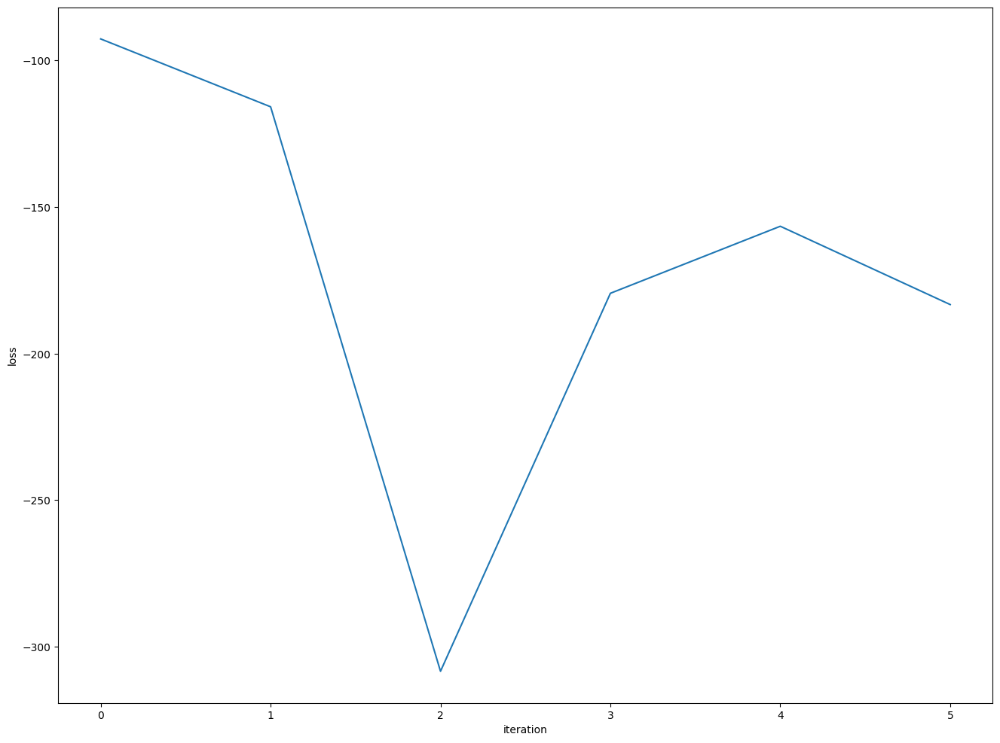

In [69]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.png")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.eps")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

Text(0, 0.5, 'loss')

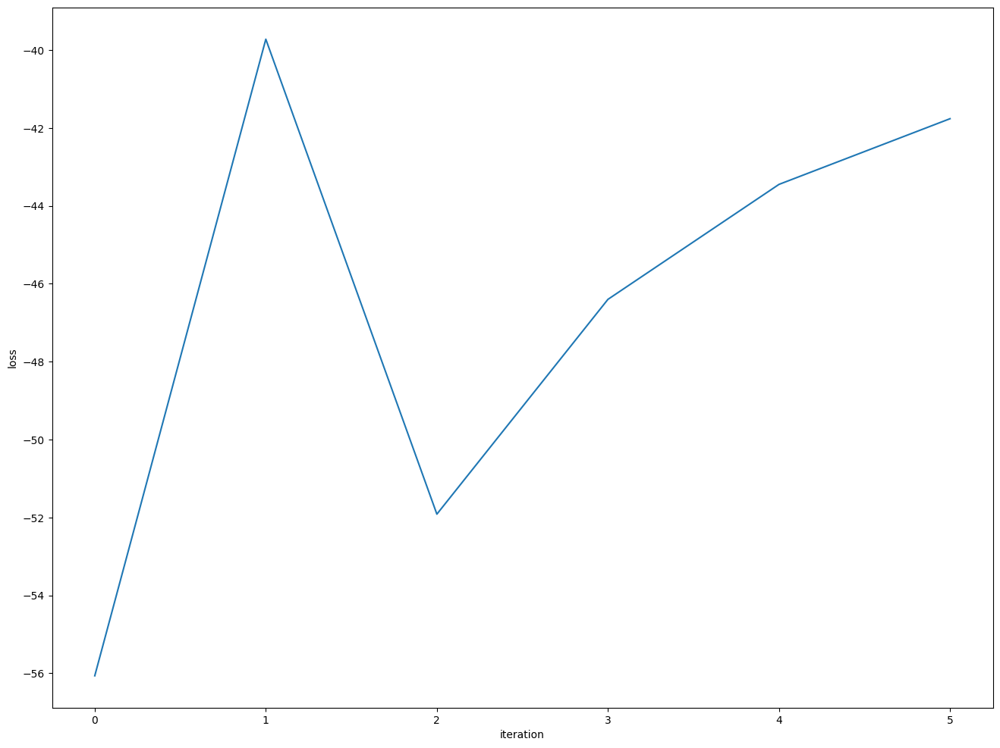

In [70]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")